In [1]:
import glob
import pickle
import datetime
import os.path as path
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from utils import calc_calibration, region_of_interest
from utils import abs_sobel_thresh, mag_thresh, dir_threshold
from utils import warper, draw_lane_field
from utils import window_mask, find_window_centroids_conv, find_window_centroids_window_search, fit_lane_line
from utils import detect_lane_curvature_v1, detect_lane_curvature_v2
# import Line


In [2]:
DEBUG_FLAG = False

## 1. Camera Calibration

In [3]:
%matplotlib inline
# Get paths of calibration test image
cal_image_files = glob.glob('camera_cal/calibration*.jpg')

# Check if we have done the camera calibration, read camera matrix, 
# vector of disortion coefficients and image size from the pickle file
if path.isfile("calibration_mtx_dist_pickle.p"):
    with open("calibration_mtx_dist_pickle.p", mode='rb') as fp:
        # read calibration information from pickle
        cali_dict = pickle.load(fp)
        mtx = cali_dict['mtx']
        dist = cali_dict['dist']
        img_size = cali_dict['image_size']

else:
    # If we have not done the calibration, do the calibration by calling utils.calc_calibration
    # and store the camera matrix, disortion coefficients and image size
    cali_dict = calc_calibration(cal_image_files)
    mtx = cali_dict['mtx']
    dist = cali_dict['dist']
    img_size = cali_dict['image_size']


## 2. Distortion correction

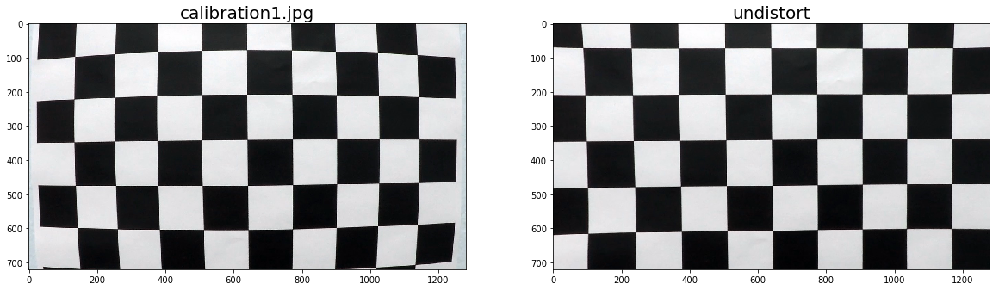

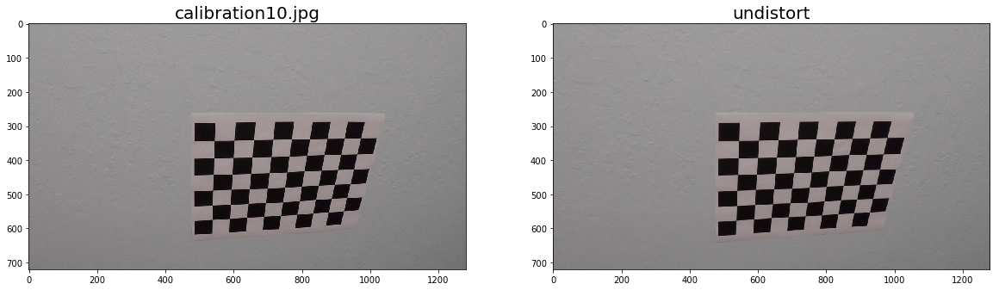

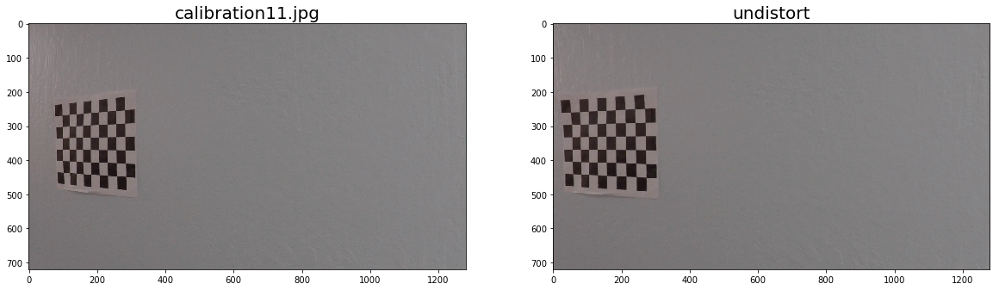

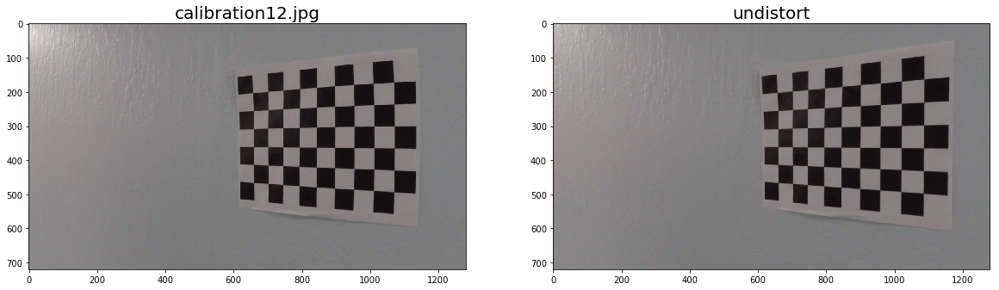

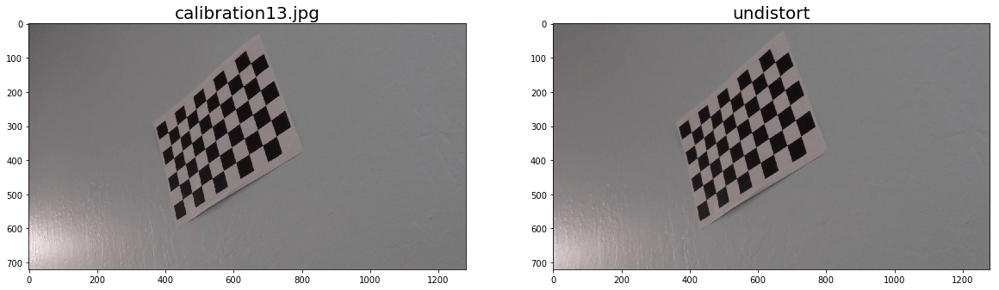

...

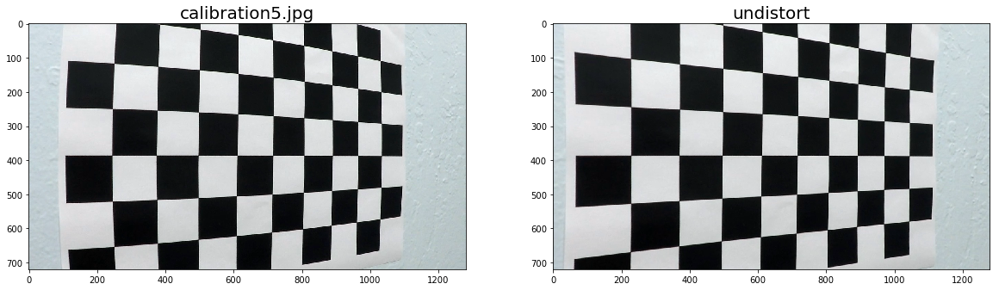

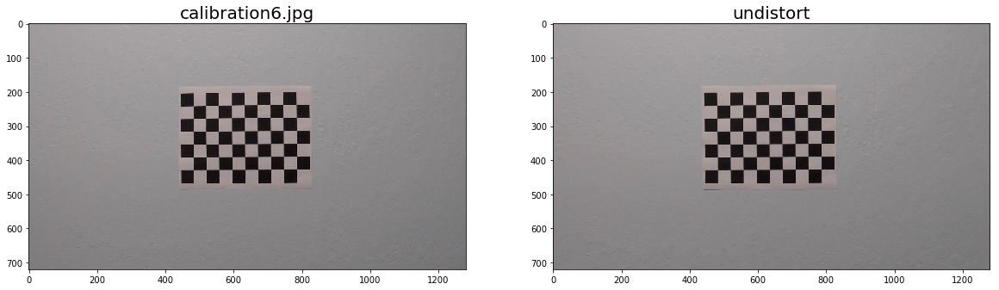

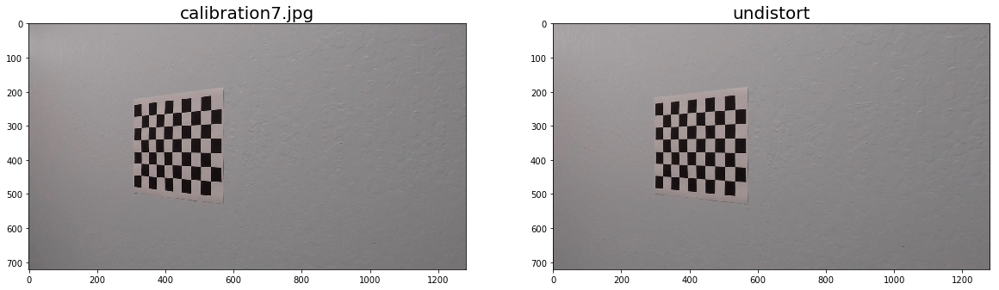

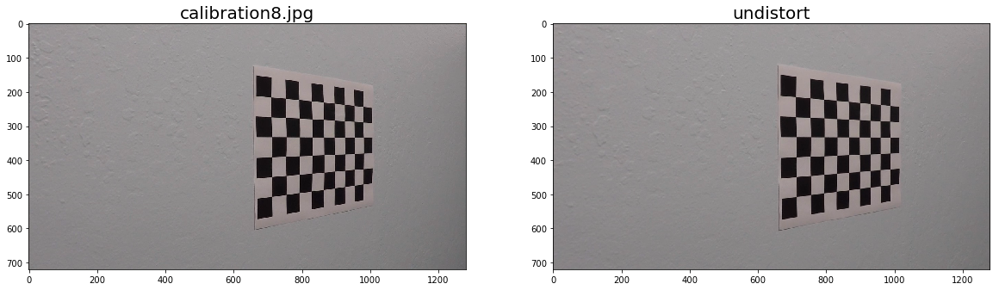

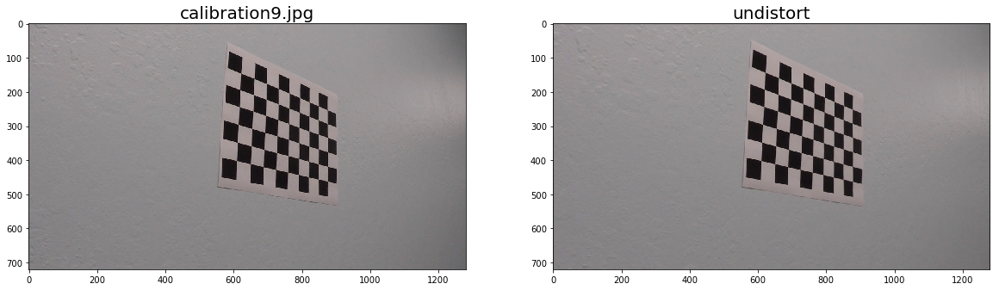

In [4]:
# Read the test image and apply undistortion to it
for image_path in cal_image_files:
    filename = image_path[image_path.rfind('/')+1:]
    test_image = cv2.imread(image_path)
    cal_test_image = cv2.undistort(src=test_image, cameraMatrix=mtx, distCoeffs=dist, dst=None, newCameraMatrix=mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(test_image)
    ax1.set_title(filename, fontsize=20)
    ax2.imshow(cal_test_image)
    ax2.set_title('undistort', fontsize=20)

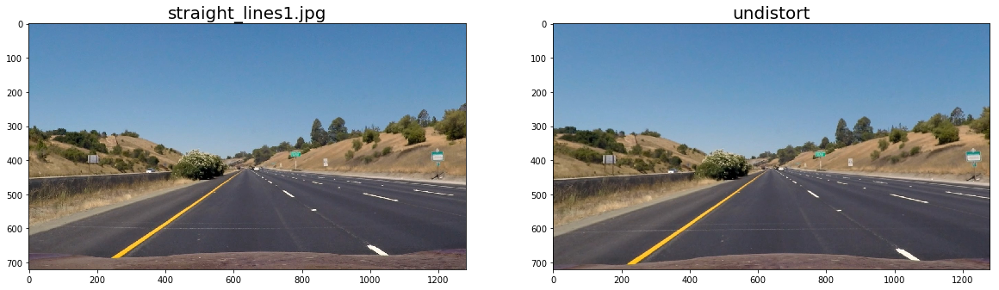

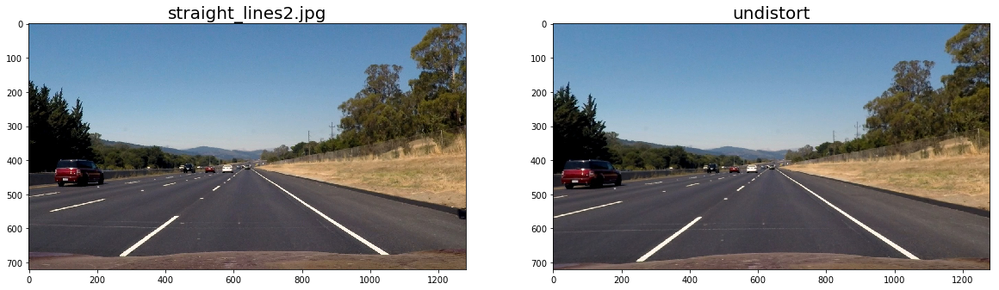

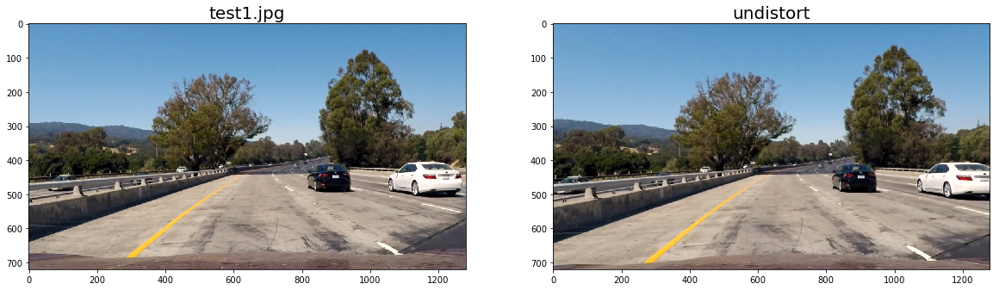

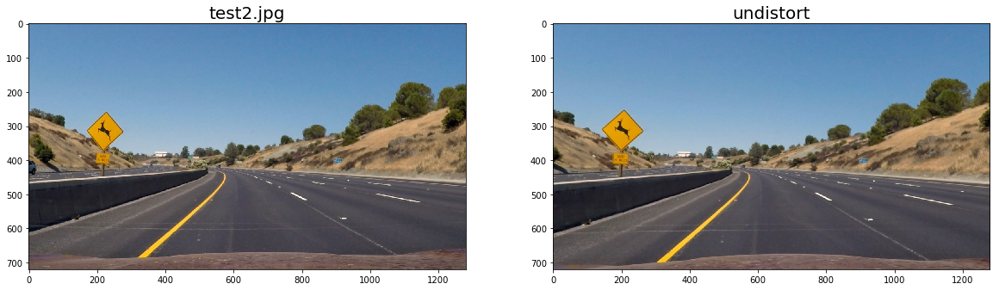

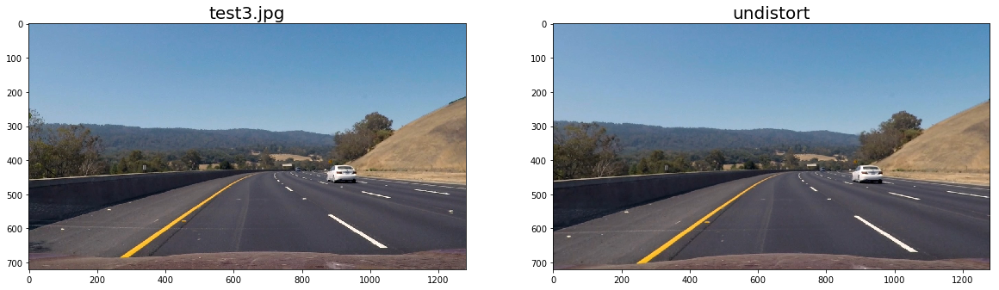

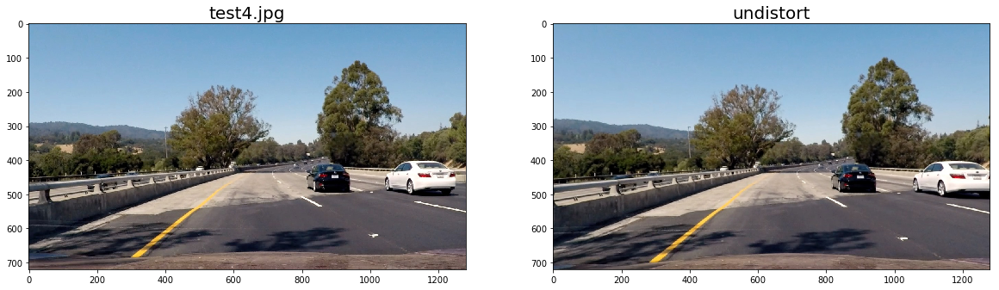

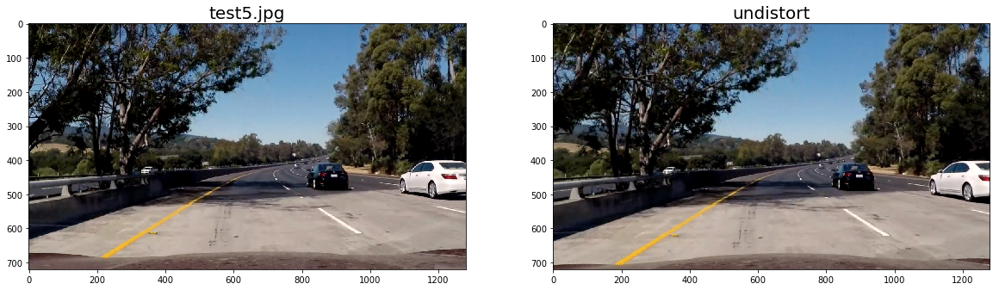

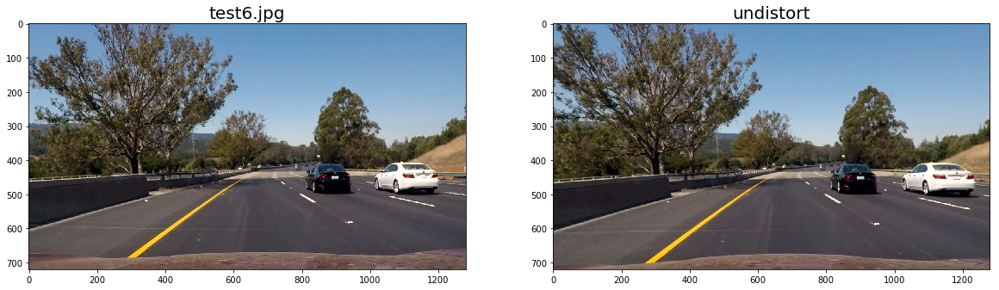

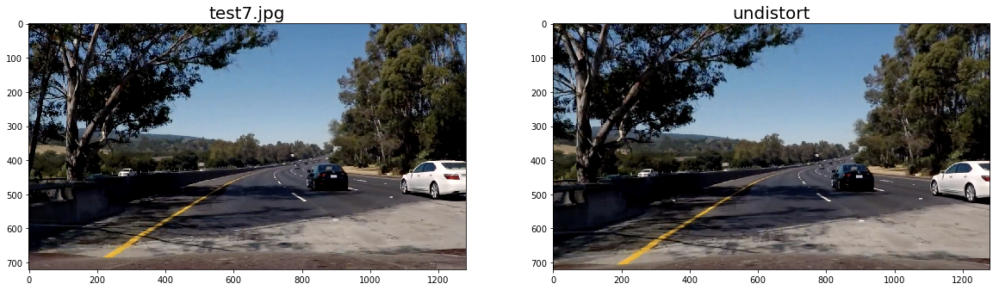

In [5]:
# apply distortion correction on test image
test_image_files = glob.glob('test_images/*.jpg')

for image_path in test_image_files:
    filename = image_path[image_path.rfind('/')+1:]
    road_image = mpimg.imread(image_path)
    cal_road_image = cv2.undistort(src=road_image, cameraMatrix=mtx, distCoeffs=dist, dst=None, newCameraMatrix=mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(road_image)
    ax1.set_title(filename, fontsize=20)
    ax2.imshow(cal_road_image)
    ax2.set_title('undistort', fontsize=20)


## 3. Color gradient threshold

In [6]:
# road_image = mpimg.imread('test_images/test5.jpg')
road_image = mpimg.imread('test_images/test1.jpg')
(image_height, image_width) = (road_image.shape[0], road_image.shape[1])

gray = cv2.cvtColor(road_image, cv2.COLOR_BGR2GRAY)
s_channel = cv2.cvtColor(road_image, cv2.COLOR_RGB2HLS)[:,:,2]
    
v_channel = cv2.cvtColor(road_image, cv2.COLOR_RGB2HSV)[:,:,2]

b_channel = cv2.cvtColor(road_image, cv2.COLOR_RGB2Lab)[:,:,2]   


# f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 10))
# ax1.imshow(gray, cmap='gray')
# ax1.set_title('gray', fontsize=20)
# ax2.imshow(s_channel, cmap='gray')
# ax2.set_title('s_channel', fontsize=20)
# ax3.imshow(v_channel, cmap='gray')
# ax3.set_title('v_channel', fontsize=20)
# ax4.imshow(b_channel, cmap='gray')
# ax4.set_title('b_channel', fontsize=20)

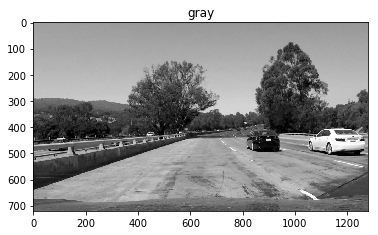

In [7]:
plt.title("gray")
cv2.imwrite('output_images/test1_gray.jpg', gray)
plt.imshow(gray, cmap='gray')

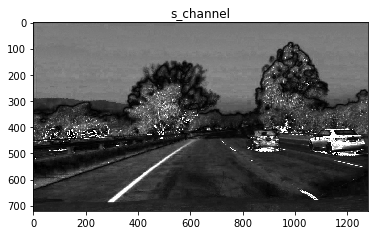

In [8]:
plt.title("s_channel")
cv2.imwrite('output_images/test1_s_ch.jpg', s_channel)
plt.imshow(s_channel, cmap='gray')

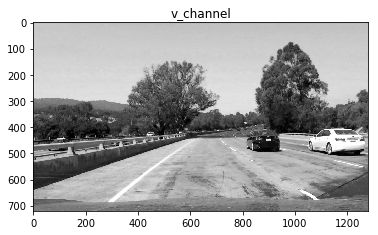

In [9]:
plt.title("v_channel")
cv2.imwrite('output_images/test1_v_ch.jpg', v_channel)
plt.imshow(v_channel, cmap='gray')

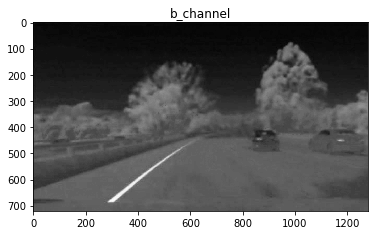

In [10]:
plt.title("b_channel")
cv2.imwrite('output_images/test1_b_ch.jpg', b_channel)
plt.imshow(b_channel, cmap='gray')

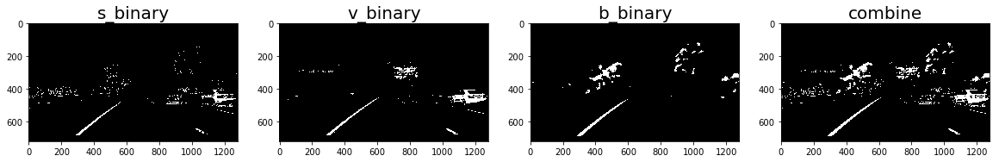

In [11]:
s_binary = np.zeros_like(s_channel)
v_binary = np.zeros_like(v_channel)
b_binary = np.zeros_like(b_channel)

s_thresh = (180, 255)
v_thresh = (225, 255)
b_thresh = (150, 255)

s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
v_binary[(v_channel >= v_thresh[0]) & (v_channel <= v_thresh[1])] = 1
b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1

combine = np.zeros_like(s_channel)
combine[(s_binary == 1)|(v_binary == 1)|(b_binary == 1)] = 1

f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 10))
ax1.imshow(s_binary, cmap='gray')
ax1.set_title('s_binary', fontsize=20)
ax2.imshow(v_binary, cmap='gray')
ax2.set_title('v_binary', fontsize=20)
ax3.imshow(b_binary, cmap='gray')
ax3.set_title('b_binary', fontsize=20)
ax4.imshow(combine, cmap='gray')
ax4.set_title('combine', fontsize=20)

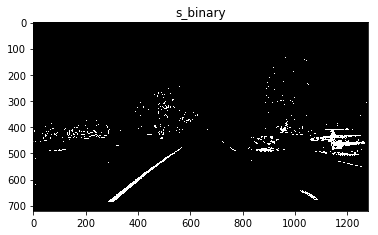

In [12]:
plt.title("s_binary")
cv2.imwrite('output_images/test1_s_binary.png', s_binary*255)
plt.imshow(s_binary, cmap='gray')

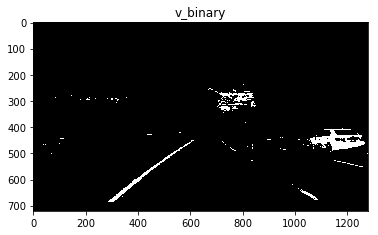

In [13]:
plt.title("v_binary")
cv2.imwrite('output_images/test1_v_binary.jpg', v_binary*255)
plt.imshow(v_binary, cmap='gray')

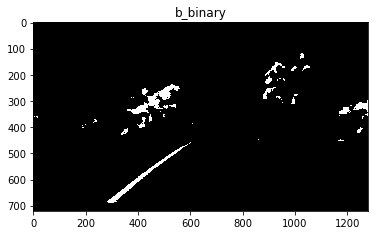

In [14]:
plt.title("b_binary")
cv2.imwrite('output_images/test1_b_binary.jpg', b_binary*255)
plt.imshow(b_binary, cmap='gray')

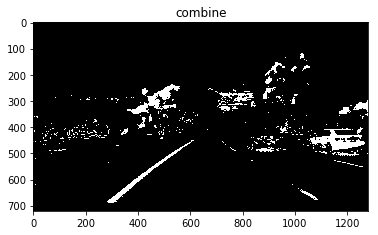

In [15]:
plt.title("combine")
cv2.imwrite('output_images/test1_combine_binary.jpg', combine*255)
plt.imshow(combine, cmap='gray')

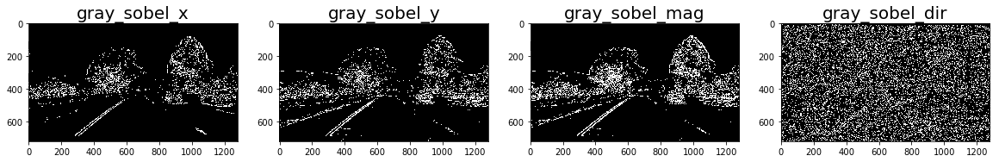

In [16]:
# sobel_x = abs_sobel_thresh(s_channel, orient='x', thresh=(39, 255))
# sobel_y = abs_sobel_thresh(s_channel, orient='y', thresh=(39, 255))
# sobel_mag = mag_thresh(s_channel, thresh=(39, 255))

def draw_sobel_result(image_src, name=''):
    sobel_x = abs_sobel_thresh(image_src, orient='x', sigma=0.66, mode='auto')
    sobel_y = abs_sobel_thresh(image_src, orient='y', sigma=0.66, mode='auto')
    sobel_mag = mag_thresh(image_src, sigma=0.66, mode='auto')
    sobel_dir = dir_threshold(image_src, thresh=(0.65, 1.05))
    
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 10))
    
    ax1.imshow(sobel_x, cmap='gray')
    title = name + '_sobel_x'
    ax1.set_title(title, fontsize=20)
    
    ax2.imshow(sobel_y, cmap='gray')
    title = name + '_sobel_y'
    ax2.set_title(title, fontsize=20)
    
    ax3.imshow(sobel_mag, cmap='gray')
    title = name + '_sobel_mag'
    ax3.set_title(title, fontsize=20)

    ax4.imshow(sobel_dir, cmap='gray')
    title = name + '_sobel_dir'
    ax4.set_title(title, fontsize=20)
    
    sobel_combine = np.zeros_like(sobel_x)
    sobel_combine[(sobel_x==1)&(sobel_y==1)|(sobel_mag==1)&(sobel_dir==1)] = 1
    
    return sobel_combine


# src_list = [('s_channel', s_channel), ('v_channel', v_channel), ('b_channel', b_channel)]
sobel_result = draw_sobel_result(s_channel, name='gray')
# plt.imshow(sobel_result)


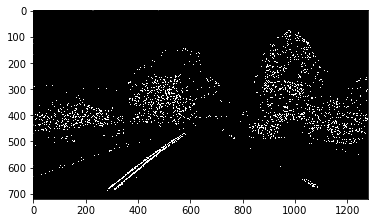

In [17]:
plt.imshow(sobel_result, cmap='gray')

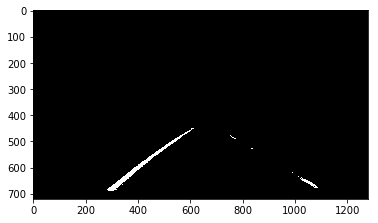

In [18]:
# combine them all
# combine = np.zeros_like(s_channel)
# combine[(combine==1) | (s_binary == 1) | (sobel_x == 1) | (sobel_y == 1) | (sobel_mag == 1)] = 1
# combine[(combine==1)|(sobel_result==1)] = 1

left_x = 40
right_x = image_width - 40
top_y = 0
bottom_y = image_height
mid_left_x = image_width / 2 - 1
mid_left_y = image_height / 2 + 60
mid_right_x = mid_left_x + 1
mid_right_y = mid_left_y
vertices = np.array([[(left_x,bottom_y),
                      (mid_left_x, mid_left_y), 
                      (mid_right_x, mid_right_y), 
                      (right_x, bottom_y)]], 
                    dtype=np.int32)
region_masked = region_of_interest(combine, vertices)
cv2.imwrite('output_images/ROI_binary.jpg', region_masked*255)
plt.imshow(region_masked, cmap='gray')

## 4. Perspective transform

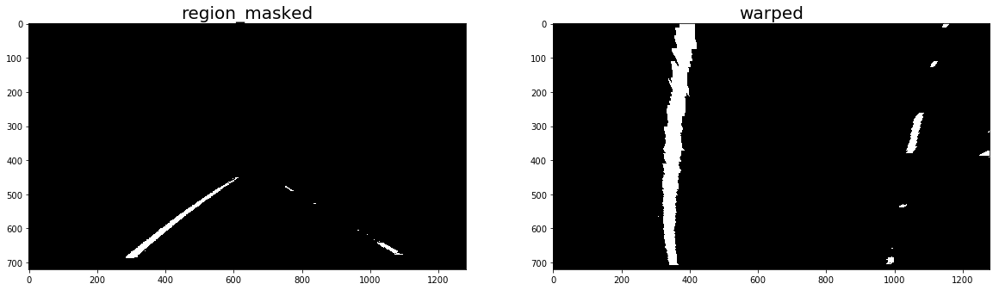

In [19]:
src = np.float32(
    [[(image_width / 2) - 55, image_height / 2 + 100],
    [((image_width / 6) - 10), image_height],
    [(image_width * 5 / 6) + 60, image_height],
    [(image_width / 2 + 55), image_height / 2 + 100]])
dst = np.float32(
    [[(image_width / 4), 0],
    [(image_width / 4), image_height],
    [(image_width * 3 / 4), image_height],
    [(image_width * 3 / 4), 0]])
# src = np.float32([[490, 482],[810, 482],
#                   [40, 720], [1250, 720]])

# dst = np.float32([[0, 0], [1280, 0], 
#                   [40, 720], [1250, 720]])

# src = np.float32([[150+430,460],[1150-440,460],[1150,720],[150,720]])
# offset = 200
# dst = np.float32([[offset, 0], 
#                       [image_width-offset, 0], 
#                       [image_width-offset, image_height], 
#                       [offset, image_height]])

# utils.perspective_transform(image, src, dst)
warped, transform_matrix = warper(combine, src, dst)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(region_masked, cmap='gray')
ax1.set_title('region_masked', fontsize=20)
ax2.imshow(warped, cmap='gray')
ax2.set_title('warped', fontsize=20)

## 5. Detect lane lines

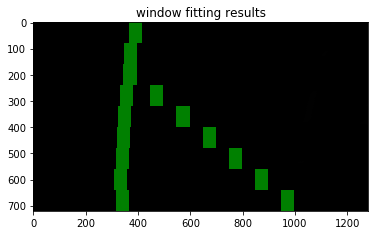

In [20]:
window_width = 50
window_height = 80
margin = 100

# utils.find_window_centroids()
window_centroids = find_window_centroids_conv(warped, window_width, window_height, margin)

if len(window_centroids) > 0:
    
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)
    
    for level in range(0, len(window_centroids)):
        # utils.window_mask()
        l_mask = window_mask(window_width, window_height, warped, window_centroids[level][0], level)
        r_mask = window_mask(window_width, window_height, warped, window_centroids[level][1], level)
        
        l_points[ (l_points == 255) | (l_mask == 1) ] = 255
        r_points[ (r_points == 255) | (r_mask == 1) ] = 255
    
    template = np.array(r_points+l_points, np.uint8)
    zero_channel = np.zeros_like(template)

    # draw window in green color
    template = np.array(cv2.merge((zero_channel, template, zero_channel)), np.uint8)
    
    warpage = np.array(cv2.merge((warped, warped, warped)), np.uint8)
    
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0)


else:
    output = np.array(cv2.merge((warped, warped, warped)), np.uint8)

    
plt.imshow(output)
plt.title('window fitting results')
plt.show()

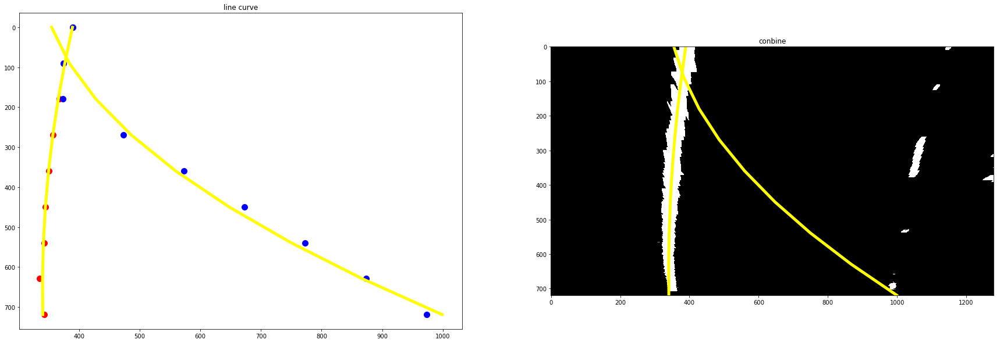

In [21]:
out_image = np.dstack((warped, warped, warped))*255

(left_fit_coeff, left_fitx, right_fit_coeff, right_fitx) = fit_lane_line(window_centroids=window_centroids, image_size=(image_width, image_height))



# Get Centroid of Left Lane
leftx = np.array([left for (left, right) in window_centroids])
# Get Centroid of Right Lane
rightx = np.array([right for (left, right) in window_centroids])
leftx = leftx[::-1]
rightx = rightx[::-1]
ploty = np.linspace(0, warped.shape[0]-1, leftx.shape[0])

# # Fit a second order polynomial to pixel positions in each lane line
# left_fit = np.polyfit(ploty, leftx, 2)
# left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
# right_fit = np.polyfit(ploty, rightx, 2)
# right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

# Plot up 
mark_size = 10
line_width = 5

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,10))
ax1.set_title('line curve')
# Draw Point
ax1.plot(leftx, ploty, 'o', color='red', markersize=mark_size)
ax1.plot(rightx, ploty, 'o', color='blue', markersize=mark_size)
# Draw curve line
ax1.plot(left_fitx, ploty, color='yellow', linewidth=line_width)
ax1.plot(right_fitx, ploty, color='yellow', linewidth=line_width)
ax1.invert_yaxis() # to visualize as we do the images

ax2.set_title('conbine')
ax2.imshow(out_image)
ax2.plot(left_fitx, ploty, color='yellow', linewidth=line_width)
ax2.plot(right_fitx, ploty, color='yellow', linewidth=line_width)

In [22]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

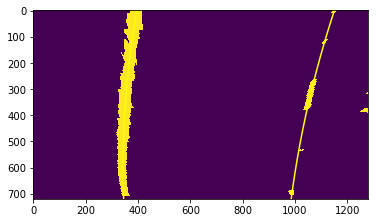

In [23]:
(left_fit_coeff, left_fitx, right_fit_coeff, right_fitx, ploty) = find_window_centroids_window_search(warped, left_line=Line(), right_line=Line())
# print('left_fit_coeff', left_fit_coeff)
# print('left_fitx', left_fitx.shape)

left_line_pt = np.reshape(np.column_stack((left_fitx, ploty)), (1, -1, 2))
right_line_pt = np.reshape(np.column_stack((right_fitx, ploty)), (1, -1, 2))
test_v2 = np.dstack((warped, warped, warped))*255

cv2.polylines(test_v2, np.int32(left_line_pt), False, (0, 255, 255), thickness=5)
cv2.polylines(test_v2, np.int32(right_line_pt), False, (0, 255, 255), thickness=5)
cv2.imwrite('output_images/bird_view_lane_line.jpg', test_v2)

plt.imshow(warped)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')

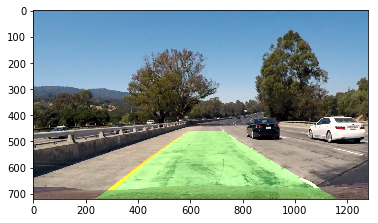

In [24]:
(invM, result) = draw_lane_field(image=road_image, warped=warped, four_point_src=src, four_point_dst=dst, x_fits=(left_fitx, right_fitx))

cv2.imwrite('output_images/draw_line.jpg', cv2.cvtColor(result, cv2.COLOR_RGB2BGR))
plt.imshow(result)



## Determine the lane curvature

In [25]:
y_eval = np.max(ploty)
left_curverad = ((1 + (2*left_fit_coeff[0]*y_eval + left_fit_coeff[1])**2)**1.5) / np.absolute(2*left_fit_coeff[0])
right_curverad = ((1 + (2*right_fit_coeff[0]*y_eval + right_fit_coeff[1])**2)**1.5) / np.absolute(2*right_fit_coeff[0])
print("Left_curverad\t: {}\nRight_curverad\t: {}".format(left_curverad, right_curverad))

Left_curverad	: 3301.5712111959465
Right_curverad	: 3762.540756296661


In [26]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print("left curverad\t: {} m \nright_curverad\t: {} m".format(left_curverad, right_curverad))

left curverad	: 1081.9918285778692 m 
right_curverad	: 1205.1492256958004 m


## Put them all togther 

In [27]:
from collections import deque
max_frame = 20
avg_left_xfitted = deque(maxlen=max_frame)
avg_left_fit = deque(maxlen=max_frame)
avg_right_xfitted = deque(maxlen=max_frame)
avg_right_fit = deque(maxlen=max_frame)

In [28]:
def check_lines_curvature(lines, curvatures):
    left_Line = lines[0]
    right_Line = lines[1]

    left_curverad = np.float32(curvatures[0])
    right_curverad = np.float32(curvatures[1])

    don = min(left_curverad, right_curverad)
    mol = max(left_curverad, right_curverad)
    ratio = mol / don
    
    l_don = min(left_curverad, np.float32(left_Line.radius_of_curvature))
    l_mol = max(left_curverad, np.float32(left_Line.radius_of_curvature))
    l_ratio = l_mol / l_don
    r_don = min(right_curverad, np.float32(right_Line.radius_of_curvature))
    r_mol = max(right_curverad, np.float32(right_Line.radius_of_curvature))
    r_ratio = r_mol / r_don

    return (ratio, l_ratio, r_ratio)

In [29]:
def check_lane_width(left_fitx, right_fitx, max_thresh, min_thresh):
    # 700 is measured by 3.7 meters in pixels
    
    dist = abs(right_fitx - left_fitx)
    min_dist = np.min(dist)
    dist = abs(dist-700)
    max_dist = np.max(dist)
    
#     print("max:", max_dist)
#     print("min:", min_dist)
    
    if max_dist > max_thresh or min_dist < min_thresh:
        return True
    else:
        return False
    

In [30]:
def find_window_centroids_check(binary_img, left_Line, right_Line):
    half = np.int(binary_img.shape[0]/2)

    # calculate histogram (vector) of the bottom half of s_binary
    # hostogram is a vector 
    histogram = np.sum(binary_img[half:, :], axis=0)
    out_image = np.dstack((binary_img, binary_img, binary_img))*255

    midpoint = int(histogram.shape[0]/2)

#     leftx_base = np.argmax(histogram[:midpoint])
#     rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # number of sliding windows
    nwindows = 9

    window_height = np.int(binary_img.shape[0]/nwindows)

    nonzero = binary_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    if left_Line.detected == True:
        leftx_current = left_Line.bestx
    else:
        leftx_current = np.argmax(histogram[:midpoint])
    
    if right_Line.detected == True:
        rightx_current = right_Line.bestx
    else:
        rightx_current = np.argmax(histogram[midpoint:]) + midpoint

    # set the width of windows +/- margin
    margin = 100

    # Set minimum number of pixels found to recenter window
    minpix = 50

    left_lane_inds = []
    right_lane_inds = []

    for window in range(nwindows):
        # 由 image 下到上移動 sliding window
        win_y_low = binary_img.shape[0] - (window+1)*window_height
        win_y_high = binary_img.shape[0] - window*window_height
        
        # 左半邊的 sliding window
        win_xleft_low = int(leftx_current - margin)
        win_xleft_high = int(leftx_current + margin)

        # 右半邊的 sliding window
        win_xright_low = int(rightx_current - margin)
        win_xright_high = int(rightx_current + margin)
        
        # Draw the windows on the visualization image
        # 畫左半邊的 sliding window
        cv2.rectangle(out_image, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (0, 255, 0), 3)
        # 畫右半邊的 sliding window
        cv2.rectangle(out_image, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (0, 255, 0), 3)
        
        

        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]

        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                          (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        left_lane_inds.append(good_left_inds)

        right_lane_inds.append(good_right_inds)
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))

        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))


    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]


    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit_coeff[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit_coeff[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])    
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    
    # Check Left and Right Lane Line have similar curvature
    (ratio, l_ratio, r_ratio) = check_lines_curvature((left_Line, right_Line), (left_curverad, right_curverad))
    # Check Lane width
    is_fail_width = check_lane_width(left_fitx, right_fitx, max_thresh=110, min_thresh=50)
    
    if ratio >=3.5:
#         print('abnormal{}, {}, {}'.format(ratio, l_ratio, r_ratio))
        if l_ratio >=3.5:
            left_fit = left_Line.current_fit
            left_fitx = left_Line.recent_xfitted
        if r_ratio >=3.5:
            right_fit = right_Line.current_fit
            right_fitx = right_Line.recent_xfitted
    elif is_fail_width == True:
#         print("abnormal lane width")
        left_fit = left_Line.current_fit
        left_fitx = left_Line.recent_xfitted
        right_fit = right_Line.current_fit
        right_fitx = right_Line.recent_xfitted
        
    else:
        # Left
#         left_Line.detected = True
        left_Line.radius_of_curvature = left_curverad
        avg_left_fit.append(left_fit)
        avg_left_xfitted.append(left_fitx)
        left_Line.current_fit = np.average(avg_left_fit, axis=0)
        left_Line.recent_xfitted = np.average(avg_left_xfitted, axis=0)
        left_Line.bestx = np.mean(left_fitx)
        
        # Right
#         right_Line.detected = True
        right_Line.radius_of_curvature = right_curverad
        avg_right_fit.append(right_fit)
        avg_right_xfitted.append(right_fitx)
        right_Line.current_fit = np.average(avg_right_fit, axis=0)
        right_Line.recent_xfitted = np.average(avg_right_xfitted, axis=0)
        right_Line.bestx = np.mean(right_fitx)

#     return (left_Line.current_fit, left_Line.recent_xfitted, right_Line.current_fit, right_Line.recent_xfitted, ploty)
    return (left_fit, left_fitx, right_fit, right_fitx, ploty)

In [31]:
def process_image(image, display_result = False):
    (image_height, image_width) = (image.shape[0], image.shape[1])
    
    cal_test_image = cv2.undistort(src=image, cameraMatrix=mtx, distCoeffs=dist, dst=None, newCameraMatrix=mtx)
    
    ###
    # Color threshold
    # convert image to the color spaces what we need
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    s_channel = cv2.cvtColor(cal_test_image, cv2.COLOR_RGB2HLS)[:,:,2]
    v_channel = cv2.cvtColor(cal_test_image, cv2.COLOR_RGB2HSV)[:,:,2]
    b_channel = cv2.cvtColor(cal_test_image, cv2.COLOR_RGB2Lab)[:,:,2]
    
    # create corresponding binary matrix
    s_binary = np.zeros_like(s_channel)
    v_binary = np.zeros_like(v_channel)
    b_binary = np.zeros_like(b_channel)
    
    # setup the corresponding threshold for each color space
    s_thresh = (180, 255)
    v_thresh = (225, 255)
    b_thresh = (150, 255)
    
    # threshold the image
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    v_binary[(v_channel >= v_thresh[0]) & (v_channel <= v_thresh[1])] = 1
    b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1
    
    # combine each binary image
    combine = np.zeros_like(s_channel)
    combine[(s_binary == 1)|(v_binary == 1)|(b_binary == 1)] = 1

    # apple sobel operation for edge detection
#     sobel_x = abs_sobel_thresh(s_channel, orient='x', sigma=0.66, mode='auto')
#     sobel_y = abs_sobel_thresh(s_channel, orient='y', sigma=0.66, mode='auto')
#     sobel_mag = mag_thresh(s_channel, sigma=0.66, mode='auto')
#     sobel_dir = dir_threshold(s_channel, thresh=(0.65, 1.05))
#     sobel_combine = np.zeros_like(sobel_x)
#     sobel_combine[(sobel_x==1)&(sobel_y==1)|(sobel_mag==1)&(sobel_dir==1)] = 1
    # combine binary and sobel image
#     combine[(combine==1)|(sobel_result==1)] = 1
    
    # setup regino of interest
    left_x = 40
    right_x = image_width - 40
    top_y = 0
    bottom_y = image_height
    mid_left_x = image_width / 2 - 1
    mid_left_y = image_height / 2 + 50
    mid_right_x = mid_left_x + 1
    mid_right_y = mid_left_y
    vertices = np.array([[(left_x,bottom_y),
                          (mid_left_x, mid_left_y), 
                          (mid_right_x, mid_right_y), 
                          (right_x, bottom_y)]], 
                        dtype=np.int32)
    region_masked = region_of_interest(combine, vertices)

    
    
    # Perspective transform
    # setup four point of source and destination for perspective transform
    src = np.float32(
        [[(image_width / 2) - 55, image_height / 2 + 100],
        [((image_width / 6) - 10), image_height],
        [(image_width * 5 / 6) + 60, image_height],
        [(image_width / 2 + 55), image_height / 2 + 100]])
    dst = np.float32(
        [[(image_width / 4), 0],
        [(image_width / 4), image_height],
        [(image_width * 3 / 4), image_height],
        [(image_width * 3 / 4), 0]])

    # utils.perspective_transform(image, src, dst)
    warped, transform_matrix = warper(region_masked, src, dst)
     
    # Detect lane lines and Determine the lane curvature
    (left_fit_coeff, left_fitx, right_fit_coeff, right_fitx, ploty) = find_window_centroids_check(warped, left_Line, right_Line)
    
    # draw land region
    (invM, draw_result) = draw_lane_field(image=image, 
                                     warped=warped, 
                                     four_point_src=src, 
                                     four_point_dst=dst, 
                                     x_fits=(left_fitx, right_fitx))
    
    center = (left_fitx[-1]+right_fitx[-1])/2
#     print('left_fitx[-1]', left_fitx[-1])
#     print('right_fitx[-1]', right_fitx[-1])
#     print("center", center)
#     print('image_width/2:', image_width/2)
    dist_to_cent = abs(image_width/2 - center)*3.7/700
    
    if draw_result is None:
        print("no draw result")
    
    # Draw Text on result image
    font = cv2.FONT_HERSHEY_SIMPLEX
    if center < 640:
        text = "Vehicle is {:.2f}m left of center".format(dist_to_cent)
    else:
        text = "Vehicle is {:.2f}m right of center".format(dist_to_cent)
    cv2.putText(draw_result,text,(400,100), font, 1,(255,255,255),2)
    text = "Radius of Left Curvature: {} m".format(int(left_Line.radius_of_curvature))
    cv2.putText(draw_result,text,(400,130), font, 1,(255,255,255),2)
    text = "Radius of Right Curvature: {} m".format(int(right_Line.radius_of_curvature))
    cv2.putText(draw_result,text,(400,160), font, 1,(255,255,255),2)
    
    if display_result == True:
        bird_view = np.dstack((warped, warped, warped))*255
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,10))
        ax1.set_title('conbine', fontsize=20)
        ax1.imshow(bird_view)
        ax1.plot(left_fitx, ploty, color='yellow', linewidth=line_width)
        ax1.plot(right_fitx, ploty, color='yellow', linewidth=line_width)

        ax2.set_title('result', fontsize=20)
        ax2.imshow(draw_result)
    
    return draw_result


 1 fail/project_video.mp4 - 00.00.39.080.jpg
max: 69.8754065216
min: 630.124593478

 2 fail/project_video.mp4 - 00.00.39.760.jpg
max: 72.7747511762
min: 627.225248824

 3 fail/project_video.mp4 - 00.00.40.920.jpg
max: 199.867195496
min: 671.428732532

 4 fail/project_video.mp4 - 00.00.41.400.jpg
max: 516.40343508
min: 183.59656492

 5 fail/project_video.mp4 - 00.00.41.520.jpg
max: 2396.41872913
min: 0.268714785247

 6 fail/project_video.mp4 - 00.00.41.600.jpg
max: 699.809559796
min: 0.190440203655

 7 fail/project_video.mp4 - 00.00.41.680.jpg
max: 569.818662662
min: 130.181337338

 8 fail/project_video.mp4 - 00.00.41.760.jpg
max: 790.407077961
min: 1.72787211451

 9 fail/project_video.mp4 - 00.00.41.840.jpg
max: 698.936513138
min: 1.06348686167

 10 fail/project_video.mp4 - 00.00.41.920.jpg
max: 359.880398427
min: 340.119601573

 11 fail/project_video.mp4 - 00.00.42.000.jpg
max: 1352.70641348
min: 0.190189388639

 12 fail/project_video.mp4 - 00.00.42.120.jpg
max: 86.3400185116
min: 66

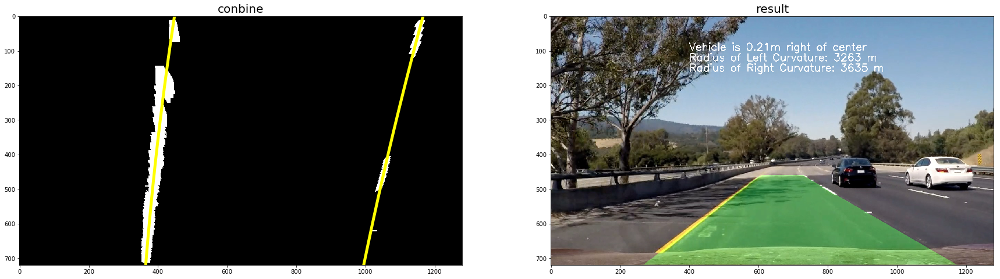

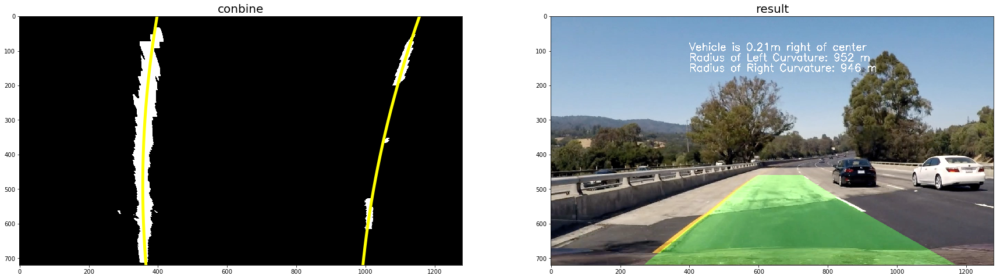

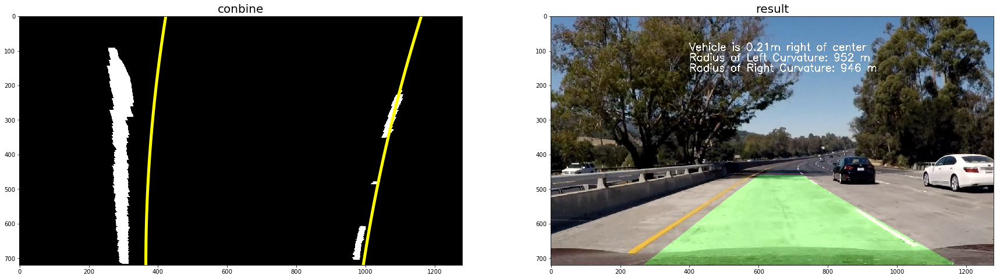

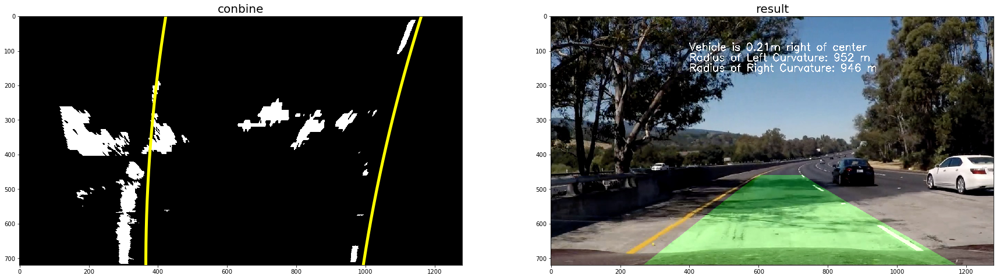

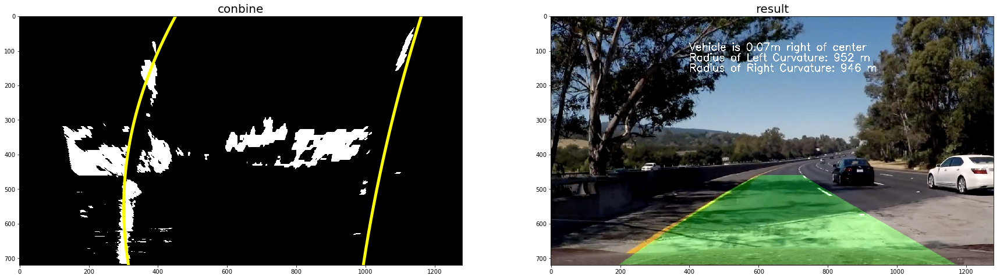

...

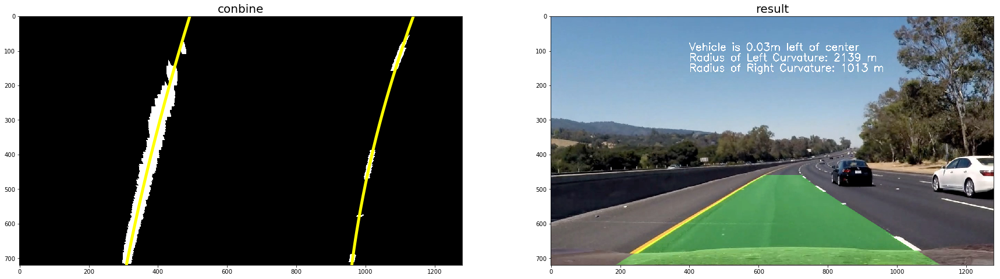

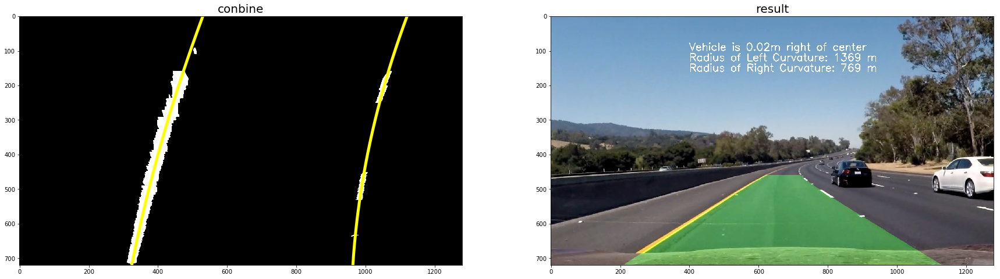

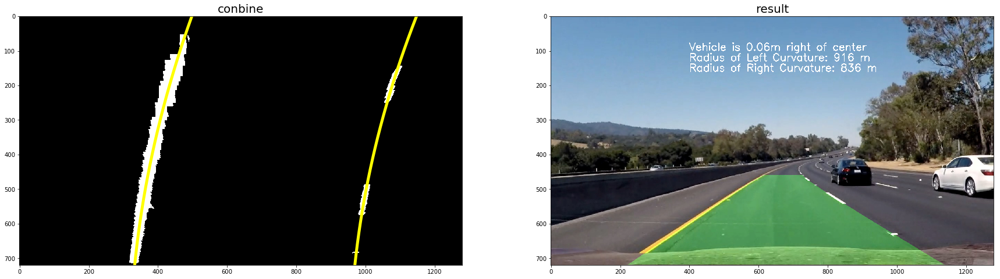

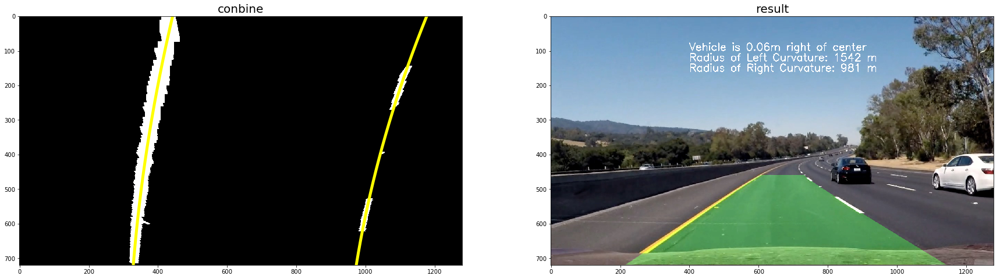

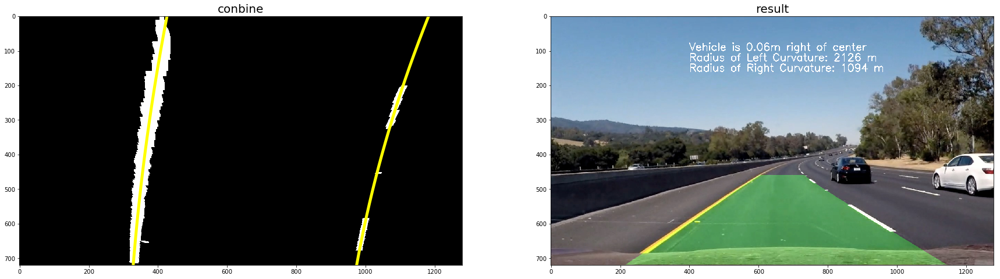

In [32]:
left_Line = Line()
right_Line = Line()

test_image_files = glob.glob('fail/*.jpg')
for index, image_path in enumerate(test_image_files):
    image = mpimg.imread(image_path)
    print('\n', index+1, image_path,)
    result = process_image(image, display_result=True)

In [33]:
from moviepy.editor import VideoFileClip
bRecord = True
if bRecord == True:
    project_video_output = 'project_video_output.mp4'
    clip1 = VideoFileClip("project_video.mp4")
    proj_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
    %time proj_clip.write_videofile(project_video_output, audio=False)

#     project_video_output = 'challenge_video_output.mp4'
#     clip1 = VideoFileClip("challenge_video.mp4")
#     proj_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
#     %time proj_clip.write_videofile(project_video_output, audio=False)
    
#     project_video_output = 'harder_challenge_video_output.mp4'
#     clip1 = VideoFileClip("harder_challenge_video.mp4")
#     proj_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
#     %time proj_clip.write_videofile(project_video_output, audio=False)

max: 63.6782485894
min: 636.321751411
[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


  0%|          | 1/1261 [00:00<02:09,  9.75it/s]

max: 63.6782485894
min: 636.321751411


  0%|          | 2/1261 [00:00<02:10,  9.63it/s]

max: 64.9350543018
min: 635.064945698


  0%|          | 3/1261 [00:00<02:20,  8.95it/s]

max: 65.4911063726
min: 634.508893627


  0%|          | 4/1261 [00:00<02:28,  8.45it/s]

max: 68.581476991
min: 631.418523009


  0%|          | 5/1261 [00:00<02:31,  8.28it/s]

max: 69.0687240939
min: 630.931275906


  0%|          | 6/1261 [00:00<02:35,  8.08it/s]

max: 70.7589907237
min: 629.241009276


  1%|          | 7/1261 [00:00<02:28,  8.44it/s]

max: 71.4366498337
min: 628.563350166


  1%|          | 8/1261 [00:00<02:23,  8.74it/s]

max: 64.6685212532
min: 635.331478747
max: 62.3918594549
min: 637.608140545


  1%|          | 11/1261 [00:01<02:25,  8.57it/s]

max: 66.4555841916
min: 633.544415808
max: 67.3297796562
min: 632.670220344


  1%|          | 14/1261 [00:01<02:13,  9.31it/s]

max: 65.7212281674
min: 634.278771833
max: 68.1650513043
min: 631.834948696
max: 67.8721107592
min: 632.127889241


  1%|▏         | 16/1261 [00:01<02:09,  9.59it/s]

max: 73.6470784335
min: 626.352921567
max: 79.954059187
min: 620.045940813
max: 80.6596455938
min: 619.340354406


  2%|▏         | 19/1261 [00:02<02:07,  9.78it/s]

max: 81.7949666094
min: 618.205033391
max: 80.5162205429
min: 619.483779457


  2%|▏         | 21/1261 [00:02<02:14,  9.24it/s]

max: 78.7386970048
min: 621.261302995
max: 76.8855495628
min: 623.114450437


  2%|▏         | 23/1261 [00:02<02:27,  8.38it/s]

max: 72.1035816854
min: 627.896418315
max: 70.4903319479
min: 629.509668052


  2%|▏         | 26/1261 [00:02<02:12,  9.32it/s]

max: 69.447629148
min: 630.552370852
max: 71.5714670548
min: 628.428532945
max: 69.0072539961
min: 630.992746004


  2%|▏         | 28/1261 [00:03<02:04,  9.88it/s]

max: 67.5865874524
min: 632.413412548
max: 62.2747683247
min: 637.725231675
max: 61.7478351884
min: 638.252164812


  2%|▏         | 30/1261 [00:03<02:03,  9.98it/s]

max: 60.3854424313
min: 639.614557569
max: 60.6596081443
min: 639.340391856
max: 63.0525938338
min: 636.947406166


  3%|▎         | 34/1261 [00:03<02:02,  9.99it/s]

max: 56.715689731
min: 643.284310269
max: 54.8544413037
min: 645.145558696
max:

  3%|▎         | 37/1261 [00:03<02:09,  9.45it/s]

 57.193314067
min: 642.806685933
max: 62.0689046654
min: 637.931095335
max: 65.3690881449
min: 634.630911855


  3%|▎         | 40/1261 [00:04<02:03,  9.88it/s]

max: 68.9457551668
min: 631.054244833
max: 74.279328606
min: 625.720671394
max: 73.5052355605
min: 626.494764439


  3%|▎         | 43/1261 [00:04<01:57, 10.35it/s]

max: 73.3991752164
min: 626.600824784
max: 73.4529720942
min: 626.547027906
max: 72.242479717
min: 627.757520283


  4%|▎         | 45/1261 [00:04<01:53, 10.74it/s]

max: 72.3335560506
min: 627.666443949
max: 72.4746488987
min: 627.525351101
max: 69.3578837975
min: 630.642116203


  4%|▎         | 47/1261 [00:04<01:49, 11.09it/s]

max: 71.4987846529
min: 628.501215347
max: 68.3654934909
min: 631.634506509
max: 68.334431595
min: 631.665568405


  4%|▍         | 51/1261 [00:05<01:52, 10.74it/s]

max: 72.8628997104
min: 627.13710029
max: 74.0160258072
min: 625.983974193
max: 80.7848601031
min: 619.215139897


  4%|▍         | 55/1261 [00:05<01:52, 10.75it/s]

max: 79.1060917743
min: 620.893908226
max: 80.7275201562
min: 619.272479844
max: 80.1196245591
min: 619.880375441


  5%|▍         | 57/1261 [00:05<01:51, 10.77it/s]

max: 79.1304586232
min: 620.869541377
max: 77.5134759243
min: 622.486524076
max: 74.5984401581
min: 625.401559842


  5%|▍         | 61/1261 [00:06<01:51, 10.80it/s]

max: 67.2491796856
min: 632.750820314
max: 70.76263545
min: 629.23736455
max: 71.9168268879
min: 628.083173112


  5%|▍         | 63/1261 [00:06<01:51, 10.77it/s]

max: 78.6964499013
min: 621.303550099
max: 74.5751468743
min: 625.424853126
max: 86.0784596814
min: 613.921540319


  5%|▌         | 67/1261 [00:06<01:51, 10.67it/s]

max: 74.3209758575
min: 625.679024143
max: 77.643569638
min: 622.356430362
max: 76.6566638179
min: 623.343336182


  5%|▌         | 69/1261 [00:06<01:55, 10.35it/s]

max: 74.6409516748
min: 625.359048325
max: 77.9429471603
min: 622.05705284
max:

  6%|▌         | 73/1261 [00:07<01:50, 10.75it/s]

 75.3745460713
min: 624.625453929
max: 73.713619946
min: 626.286380054
max: 70.792317834
min: 629.207682166
max: 75.7292373256
min: 624.270762674


  6%|▌         | 75/1261 [00:07<01:50, 10.77it/s]

max: 78.2255427016
min: 621.774457298
max: 77.4533219144
min: 622.546678086
max: 85.9199506458
min: 614.080049354


  6%|▋         | 79/1261 [00:07<01:47, 11.00it/s]

max: 81.1714991636
min: 618.828500836
max: 81.3939470733
min: 618.606052927
max: 77.7673957414
min: 622.232604259


  6%|▋         | 81/1261 [00:07<01:47, 11.02it/s]

max: 79.2879351213
min: 620.712064879
max: 77.5788258731
min: 622.421174127
max: 74.133047885
min: 625.866952115


  7%|▋         | 85/1261 [00:08<01:45, 11.10it/s]

max: 69.7720504768
min: 630.227949523
max: 46.7372704985
min: 653.262729501
max: 47.5294694794
min: 652.470530521


  7%|▋         | 87/1261 [00:08<01:46, 10.99it/s]

max: 51.9709074056
min: 648.029092594
max: 54.632922387
min: 645.367077613
max: 60.2969258173
min: 639.703074183


  7%|▋         | 91/1261 [00:08<01:46, 11.03it/s]

max: 62.4727471421
min: 637.527252858
max: 75.1260999109
min: 624.873900089
max: 67.2689454245
min: 632.731054575


  7%|▋         | 93/1261 [00:09<01:46, 10.97it/s]

max: 67.0965562608
min: 632.903443739
max: 71.497562494
min: 628.502437506
max: 73.8996563785
min: 626.100343622


  8%|▊         | 97/1261 [00:09<01:45, 11.05it/s]

max: 72.1773133339
min: 627.822686666
max: 70.9611075971
min: 629.038892403
max: 75.3055766358
min: 624.694423364


  8%|▊         | 99/1261 [00:09<01:46, 10.95it/s]

max: 71.9634259366
min: 628.036574063
max: 74.8037106502
min: 625.19628935
max: 78.1484120989
min: 621.851587901


  8%|▊         | 103/1261 [00:09<01:45, 11.03it/s]

max: 86.2947446164
min: 613.705255384
max: 86.3893537966
min: 613.610646203
max: 84.0550427126
min: 615.944957287


  8%|▊         | 105/1261 [00:10<01:47, 10.78it/s]

max: 84.0572773386
min: 615.942722661
max: 81.3339393534
min: 618.666060647
max: 77.5820993552
min: 622.417900645


  9%|▊         | 109/1261 [00:10<01:46, 10.83it/s]

max: 74.1565544922
min: 625.843445508
max: 74.0860866349
min: 625.913913365
max: 61.4469188872
min: 638.553081113


  9%|▉         | 111/1261 [00:10<01:45, 10.88it/s]

max: 66.8237523442
min: 633.176247656
max: 67.2998161471
min: 632.700183853
max: 66.1616741861
min: 633.838325814


  9%|▉         | 115/1261 [00:11<01:44, 10.99it/s]

max: 67.1292549109
min: 632.870745089
max: 69.693735326
min: 630.306264674
max: 69.756321545
min: 630.243678455


  9%|▉         | 117/1261 [00:11<01:44, 10.97it/s]

max: 77.9686100646
min: 622.031389935
max: 74.8521285807
min: 625.147871419
max: 76.5198417534
min: 623.480158247


  9%|▉         | 119/1261 [00:11<01:43, 11.01it/s]

max: 77.041290867
min: 622.958709133
max: 79.0211345893
min: 620.978865411
max: 76.2814272841
min: 623.718572716


 10%|▉         | 123/1261 [00:11<01:56,  9.80it/s]

max: 75.7028671161
min: 624.297132884
max: 76.4939779566
min: 623.506022043


 10%|▉         | 125/1261 [00:12<02:05,  9.06it/s]

max: 78.2329553136
min: 621.767044686
max: 79.2156821227
min: 620.784317877


 10%|█         | 127/1261 [00:12<02:05,  9.07it/s]

max: 77.7261749975
min: 622.273825003
max: 80.6192024286
min: 619.380797571


 10%|█         | 129/1261 [00:12<02:02,  9.21it/s]

max: 80.6971182279
min: 619.302881772
max: 84.3256816064
min: 615.674318394


 10%|█         | 130/1261 [00:12<02:01,  9.34it/s]

max: 84.2744116738
min: 615.725588326
max: 84.003324276
min: 615.996675724
max:

 11%|█         | 134/1261 [00:13<02:13,  8.43it/s]

 84.5375915004
min: 615.4624085
max: 83.6172919713
min: 616.382708029
max: 76.9061300263
min: 623.093869974


 11%|█         | 135/1261 [00:13<02:09,  8.69it/s]

max: 80.3009103865
min: 619.699089613
max: 78.9350087277
min: 621.064991272
max: 77.6837593998
min: 622.3162406


 11%|█         | 139/1261 [00:13<01:56,  9.60it/s]

max: 75.4486160821
min: 624.551383918
max: 81.3073767129
min: 618.692623287
max: 72.1527892672
min: 627.847210733


 11%|█▏        | 143/1261 [00:14<01:54,  9.74it/s]

max: 72.4543809274
min: 627.545619073
max: 72.4925705069
min: 627.507429493
max: 75.0886596392
min: 624.911340361


 12%|█▏        | 146/1261 [00:14<01:50, 10.10it/s]

max: 75.3268648443
min: 624.673135156
max: 74.3303545209
min: 625.669645479
max: 75.149814068
min: 624.850185932


 12%|█▏        | 148/1261 [00:14<01:47, 10.33it/s]

max: 64.0775604082
min: 635.922439592
max: 73.2717432425
min: 626.728256757
max: 73.8433532252
min: 626.156646775


 12%|█▏        | 150/1261 [00:14<01:46, 10.41it/s]

max: 74.0544135298
min: 625.94558647
max: 77.7212580611
min: 622.278741939


 12%|█▏        | 152/1261 [00:14<01:49, 10.15it/s]

max: 76.2186347358
min: 623.781365264
max: 76.5160119499
min: 623.48398805


 12%|█▏        | 155/1261 [00:15<02:06,  8.77it/s]

max: 78.9398736895
min: 621.06012631
max: 73.1899020204
min: 626.81009798


 13%|█▎        | 158/1261 [00:15<01:56,  9.47it/s]

max: 73.2811272137
min: 626.718872786
max: 73.9494502764
min: 626.050549724
max: 75.0333511008
min: 624.966648899


 13%|█▎        | 159/1261 [00:15<01:55,  9.58it/s]

max: 65.1534491643
min: 634.846550836
max: 63.5590960891
min: 636.440903911


 13%|█▎        | 162/1261 [00:16<01:55,  9.54it/s]

max: 58.7355141523
min: 641.264485848
max: 63.5783192351
min: 636.421680765


 13%|█▎        | 164/1261 [00:16<01:53,  9.64it/s]

max: 59.9667120442
min: 640.033287956
max: 60.3282353429
min: 639.671764657
max: 66.1577446369
min: 633.842255363


 13%|█▎        | 168/1261 [00:16<01:46, 10.28it/s]

max: 66.0405450492
min: 633.959454951
max: 68.9537207481
min: 631.046279252
max: 67.6651403595
min: 632.334859641


 13%|█▎        | 170/1261 [00:16<01:46, 10.22it/s]

max: 68.4047651972
min: 631.595234803
max: 67.8354961291
min: 632.164503871


 14%|█▎        | 172/1261 [00:16<01:46, 10.23it/s]

max: 70.2623216277
min: 629.737678372
max: 71.7391887582
min: 628.260811242
max: 72.0108854095
min: 627.989114591


 14%|█▍        | 176/1261 [00:17<01:41, 10.71it/s]

max: 77.0149022509
min: 622.985097749
max: 74.9201330643
min: 625.079866936
max: 81.8085137732
min: 618.191486227


 14%|█▍        | 178/1261 [00:17<01:40, 10.79it/s]

max: 78.3975781312
min: 621.602421869
max: 73.5024266677
min: 626.497573332
max: 69.0982315095
min: 630.90176849


 14%|█▍        | 182/1261 [00:17<01:38, 10.97it/s]

max: 63.2884342
min: 636.7115658
max: 62.0682906592
min: 637.931709341
max: 57.334414271
min: 642.665585729


 15%|█▍        | 184/1261 [00:18<01:37, 10.99it/s]

max: 61.3736927057
min: 638.626307294
max: 69.6292357383
min: 630.370764262
max: 78.9333552278
min: 621.066644772


 15%|█▍        | 188/1261 [00:18<01:36, 11.10it/s]

max: 105.516937652
min: 594.483062348
max: 111.071842245
min: 588.928157755
max: 123.089217898
min: 576.910782102


 15%|█▌        | 190/1261 [00:18<01:38, 10.89it/s]

max: 120.963638985
min: 579.036361015
max: 118.939859988
min: 581.060140012
max: 131.967368525
min: 568.032631475


 15%|█▌        | 194/1261 [00:18<01:38, 10.84it/s]

max: 125.131459178
min: 574.868540822
max: 135.005884283
min: 564.994115717
max: 96.144236299
min: 603.855763701


 16%|█▌        | 196/1261 [00:19<01:40, 10.64it/s]

max: 102.701218227
min: 597.298781773
max: 68.9292419628
min: 631.070758037
max:

 16%|█▌        | 198/1261 [00:19<01:40, 10.55it/s]

 64.1171859282
min: 635.882814072
max: 58.4077820228
min: 641.592217977
max: 56.1563097486
min: 643.843690251


 16%|█▌        | 201/1261 [00:19<02:03,  8.57it/s]

max: 55.892447002
min: 644.107552998
max: 57.3614682585
min: 642.638531742


 16%|█▌        | 203/1261 [00:20<02:04,  8.48it/s]

max: 58.4743728083
min: 641.525627192
max: 59.5002876772
min: 640.499712323


 16%|█▋        | 205/1261 [00:20<01:55,  9.11it/s]

max: 58.1466026997
min: 641.8533973
max: 60.2847142678
min: 639.715285732
max: 60.5227454896
min: 639.47725451


 16%|█▋        | 208/1261 [00:20<02:01,  8.67it/s]

max: 67.042204766
min: 632.957795234
max: 69.3782019071
min: 630.621798093


 17%|█▋        | 210/1261 [00:20<02:03,  8.53it/s]

max: 59.4072410752
min: 640.592758925
max: 57.7398281901
min: 642.26017181


 17%|█▋        | 211/1261 [00:20<01:58,  8.87it/s]

max: 55.7953295395
min: 644.204670461
max: 55.7477022921
min: 644.252297708
max: 59.6910177636
min: 640.308982236


 17%|█▋        | 215/1261 [00:21<01:49,  9.54it/s]

max: 60.4347493728
min: 639.565250627
max: 64.022019491
min: 635.977980509


 17%|█▋        | 217/1261 [00:21<01:50,  9.49it/s]

max: 63.901297643
min: 636.098702357
max: 64.1022921041
min: 635.897707896
max: 65.1682996221
min: 634.831700378


 17%|█▋        | 220/1261 [00:21<01:46,  9.77it/s]

max: 67.2025967105
min: 632.79740329
max: 66.399984738
min: 633.600015262
max:

 18%|█▊        | 223/1261 [00:22<01:41, 10.18it/s]

 56.6770201567
min: 643.322979843
max: 58.3255868995
min: 641.674413101
max: 59.1442899856
min: 640.855710014
max: 66.9851605026
min: 633.014839497


 18%|█▊        | 227/1261 [00:22<01:36, 10.74it/s]

max: 67.2270002182
min: 632.772999782
max: 69.6938233238
min: 630.306176676
max: 71.7955603542
min: 628.204439646


 18%|█▊        | 229/1261 [00:22<01:34, 10.88it/s]

max: 72.8463781174
min: 627.153621883
max: 74.4318492582
min: 625.568150742
max: 75.5566643506
min: 624.443335649


 18%|█▊        | 233/1261 [00:22<01:33, 11.04it/s]

max: 77.5702889847
min: 622.429711015
max: 76.8273310637
min: 623.172668936
max: 74.0250060282
min: 625.974993972


 19%|█▊        | 235/1261 [00:23<01:33, 10.98it/s]

max: 70.1792422644
min: 629.820757736
max: 70.1082613353
min: 629.891738665
max: 72.0003522347
min: 627.999647765


 19%|█▉        | 239/1261 [00:23<01:33, 10.96it/s]

max: 74.2388386346
min: 625.761161365
max: 73.845857344
min: 626.154142656
max: 73.1041085075
min: 626.895891493


 19%|█▉        | 241/1261 [00:23<01:32, 11.05it/s]

max: 71.5222816028
min: 628.477718397
max: 71.7984361491
min: 628.201563851
max: 67.9593140384
min: 632.040685962


 19%|█▉        | 245/1261 [00:24<01:30, 11.18it/s]

max: 68.8299839808
min: 631.170016019
max: 68.7768746391
min: 631.223125361
max: 62.4451337604
min: 637.55486624


 20%|█▉        | 247/1261 [00:24<01:30, 11.15it/s]

max: 66.9317651267
min: 633.068234873
max: 61.3355172273
min: 638.664482773
max: 75.6494499304
min: 624.35055007


 20%|█▉        | 251/1261 [00:24<01:29, 11.26it/s]

max: 64.9342641109
min: 635.065735889
max: 66.2104536042
min: 633.789546396
max: 65.4201636503
min: 634.57983635


 20%|██        | 253/1261 [00:24<01:30, 11.16it/s]

max: 65.1590845514
min: 634.840915449
max: 67.796443201
min: 632.203556799
max: 66.5929948056
min: 633.407005194


 20%|██        | 257/1261 [00:25<01:30, 11.12it/s]

max: 67.6292174182
min: 632.370782582
max: 66.8883058711
min: 633.111694129
max: 61.3304408147
min: 638.669559185


 21%|██        | 259/1261 [00:25<01:30, 11.13it/s]

max: 64.7182255795
min: 635.28177442
max: 62.2227362365
min: 637.777263763
max: 66.2072248633
min: 633.792775137


 21%|██        | 261/1261 [00:25<01:31, 10.94it/s]

max: 66.1972251832
min: 633.802774817
max: 71.1820121628
min: 628.817987837


 21%|██        | 263/1261 [00:25<01:35, 10.46it/s]

max: 70.7166903883
min: 629.283309612
max: 70.7213186886
min: 629.278681311
max: 68.1509398474
min: 631.849060153


 21%|██        | 267/1261 [00:26<01:33, 10.64it/s]

max: 64.2251620336
min: 635.774837966
max: 64.8778460707
min: 635.122153929
max: 63.5251970397
min: 636.47480296


 21%|██▏       | 270/1261 [00:26<01:51,  8.86it/s]

max: 59.7325004845
min: 640.267499516
max: 46.4814877412
min: 653.518512259


 21%|██▏       | 271/1261 [00:26<01:50,  8.95it/s]

max: 52.8993080336
min: 647.100691966
max: 55.7278281158
min: 644.272171884
max: 58.3885139022
min: 641.611486098


 22%|██▏       | 275/1261 [00:26<01:41,  9.73it/s]

max: 67.1971769743
min: 632.802823026
max: 63.9468112883
min: 636.053188712
max: 62.3439493072
min: 637.656050693


 22%|██▏       | 278/1261 [00:27<01:47,  9.13it/s]

max: 61.977436385
min: 638.022563615
max: 61.7741466663
min: 638.225853334


 22%|██▏       | 280/1261 [00:27<01:54,  8.60it/s]

max: 64.6621080773
min: 635.337891923
max: 66.8024709993
min: 633.197529001


 22%|██▏       | 282/1261 [00:27<01:55,  8.44it/s]

max: 62.7351695177
min: 637.264830482
max: 62.3660162941
min: 637.633983706


 23%|██▎       | 284/1261 [00:28<01:57,  8.29it/s]

max: 62.1079492974
min: 637.892050703
max: 62.5904996894
min: 637.409500311


 23%|██▎       | 286/1261 [00:28<02:05,  7.78it/s]

max: 65.131420559
min: 634.868579441
max: 61.7888783203
min: 638.21112168


 23%|██▎       | 288/1261 [00:28<02:09,  7.52it/s]

max: 62.3141173132
min: 637.685882687
max: 60.5082020946
min: 639.491797905


 23%|██▎       | 290/1261 [00:28<02:08,  7.58it/s]

max: 65.4499326091
min: 634.550067391
max: 63.9879162198
min: 636.01208378


 23%|██▎       | 293/1261 [00:29<01:49,  8.81it/s]

max: 65.0869477081
min: 634.913052292
max: 66.7941017253
min: 633.205898275
max: 61.8529205298
min: 638.14707947


 23%|██▎       | 295/1261 [00:29<01:52,  8.56it/s]

max: 64.5202750688
min: 635.479724931
max: 62.7203047041
min: 637.279695296


 23%|██▎       | 296/1261 [00:29<01:52,  8.58it/s]

max: 65.5151012275
min: 634.484898773
max: 68.0742955932
min: 631.925704407
max: 68.7824935107
min: 631.217506489


 24%|██▍       | 300/1261 [00:29<01:40,  9.56it/s]

max: 68.3764809536
min: 631.623519046
max: 67.702774719
min: 632.297225281
max: 66.9247839599
min: 633.07521604


 24%|██▍       | 303/1261 [00:30<01:48,  8.85it/s]

max: 62.8032821291
min: 637.196717871
max: 63.7694345253
min: 636.230565475


 24%|██▍       | 305/1261 [00:30<01:52,  8.49it/s]

max: 64.3614534618
min: 635.638546538
max: 46.9351650064
min: 653.064834994


 24%|██▍       | 307/1261 [00:30<01:46,  8.92it/s]

max: 51.6834686783
min: 648.316531322
max: 51.6734476167
min: 648.326552383
max: 57.7995410526
min: 642.200458947


 25%|██▍       | 310/1261 [00:30<01:41,  9.36it/s]

max: 57.5254986502
min: 642.47450135
max: 60.8920672167
min: 639.107932783


 25%|██▍       | 312/1261 [00:31<01:47,  8.85it/s]

max: 66.3754537875
min: 633.624546213
max: 68.1775342595
min: 631.822465741


 25%|██▍       | 314/1261 [00:31<01:50,  8.60it/s]

max: 89.4757476395
min: 610.524252361
max: 78.3561866247
min: 621.643813375


 25%|██▌       | 316/1261 [00:31<01:42,  9.18it/s]

max: 73.9073391037
min: 626.092660896
max: 73.7641115755
min: 626.235888425
max: 69.3440624263
min: 630.655937574


 25%|██▌       | 319/1261 [00:31<01:37,  9.64it/s]

max: 74.5848612847
min: 625.415138715
max: 72.0418995324
min: 627.958100468
max: 77.9382932113
min: 622.061706789

 25%|██▌       | 321/1261 [00:32<01:33, 10.03it/s]


max: 77.6136850225
min: 622.386314977
max: 86.0802360684
min: 613.919763932


 26%|██▌       | 324/1261 [00:32<01:36,  9.75it/s]

max: 86.3737962569
min: 613.626203743
max: 83.0344999286
min: 616.965500071


 26%|██▌       | 326/1261 [00:32<01:39,  9.41it/s]

max: 81.8331661182
min: 618.166833882
max: 79.9612437888
min: 620.038756211


 26%|██▌       | 329/1261 [00:32<01:34,  9.87it/s]

max: 77.2402764222
min: 622.759723578
max: 76.004463843
min: 623.995536157
max: 62.0579710283
min: 637.942028972


 26%|██▌       | 331/1261 [00:33<01:30, 10.24it/s]

max: 64.6753603556
min: 635.324639644
max: 60.5615200239
min: 639.438479976
max: 77.3898456266
min: 622.610154373


 26%|██▋       | 333/1261 [00:33<01:32, 10.06it/s]

max: 89.3175208668
min: 610.682479133
max: 80.5613592378
min: 619.438640762
max: 81.2679827005
min: 618.7320173

 27%|██▋       | 337/1261 [00:33<01:29, 10.36it/s]


max: 69.1000029847
min: 630.899997015
max: 67.0716661678
min: 632.928333832
max: 68.6256293387
min: 631.374370661


 27%|██▋       | 341/1261 [00:34<01:25, 10.82it/s]

max: 68.9701955866
min: 631.029804413
max: 72.2773337004
min: 627.7226663
max: 68.6657761744
min: 631.334223826


 27%|██▋       | 343/1261 [00:34<01:24, 10.81it/s]

max: 82.6666944769
min: 617.333305523
max: 70.5371093795
min: 629.46289062
max: 70.1283989363
min: 629.871601064


 27%|██▋       | 345/1261 [00:34<01:24, 10.81it/s]

max: 69.5746200099
min: 630.42537999
max: 69.810280034
min: 630.189719966


 28%|██▊       | 347/1261 [00:34<01:30, 10.14it/s]

max: 75.7080891165
min: 624.291910883
max: 75.2311074771
min: 624.768892523


 28%|██▊       | 350/1261 [00:34<01:38,  9.27it/s]

max: 72.9945644694
min: 627.005435531
max: 70.1121209558
min: 629.887879044


 28%|██▊       | 352/1261 [00:35<01:37,  9.29it/s]

max: 69.8717447038
min: 630.128255296
max: 68.6242027771
min: 631.375797223


 28%|██▊       | 353/1261 [00:35<01:37,  9.29it/s]

max: 65.0124164094
min: 634.987583591
max: 59.8024630093
min: 640.197536991
max: 55.7281597335
min: 644.271840267


 28%|██▊       | 357/1261 [00:35<01:36,  9.34it/s]

max: 62.2304632232
min: 637.769536777
max: 64.1867654751
min: 635.813234525


 29%|██▊       | 360/1261 [00:36<01:31,  9.86it/s]

max: 69.0999435688
min: 630.900056431
max: 76.6512864586
min: 623.348713541
max: 77.7621042455
min: 622.237895755


 29%|██▊       | 362/1261 [00:36<01:32,  9.69it/s]

max: 78.0351615097
min: 621.96483849
max: 81.9334112346
min: 618.066588765
max:

 29%|██▉       | 364/1261 [00:36<01:29,  9.99it/s]

 84.6666830205
min: 615.333316979
max: 85.8057287151
min: 614.194271285
max: 79.6161979575
min: 620.383802043
max: 81.1140251364
min: 618.885974864


 29%|██▉       | 368/1261 [00:36<01:29,  9.96it/s]

max: 79.5717614508
min: 620.428238549
max: 79.1699298496
min: 620.83007015


 29%|██▉       | 370/1261 [00:37<01:31,  9.71it/s]

max: 83.1866575932
min: 616.813342407
max: 80.7625186277
min: 619.237481372


 30%|██▉       | 373/1261 [00:37<01:28, 10.04it/s]

max: 77.5362711659
min: 622.463728834
max: 76.3128618709
min: 623.687138129
max: 71.8389946514
min: 628.161005349


 30%|██▉       | 375/1261 [00:37<01:30,  9.84it/s]

max: 69.2870182442
min: 630.712981756
max: 67.7894143463
min: 632.210585654


 30%|██▉       | 377/1261 [00:37<01:34,  9.33it/s]

max: 83.48759601
min: 616.51240399
max: 75.6335006204
min: 624.36649938


 30%|██▉       | 378/1261 [00:37<01:35,  9.22it/s]

max: 77.6165338849
min: 622.383466115
max: 70.2166307478
min: 629.783369252
max: 65.7339957019
min: 634.266004298


 30%|███       | 382/1261 [00:38<01:33,  9.41it/s]

max: 61.2729172867
min: 638.727082713
max: 62.26593475
min: 637.73406525


 30%|███       | 384/1261 [00:38<01:34,  9.25it/s]

max: 65.9099435551
min: 634.090056445
max: 67.0122500274
min: 632.987749973


 31%|███       | 387/1261 [00:38<01:29,  9.76it/s]

max: 67.6017357226
min: 632.398264277
max: 68.3415042567
min: 631.658495743
max: 67.7422775353
min: 632.257722465


 31%|███       | 389/1261 [00:38<01:27,  9.97it/s]

max: 69.8052324538
min: 630.194767546
max: 68.4748101925
min: 631.525189807
max: 61.8415614222
min:

 31%|███       | 392/1261 [00:39<01:30,  9.62it/s]

 638.158438578
max: 60.8255635573
min: 639.174436443
max: 66.0873603657
min: 633.912639634


 31%|███       | 393/1261 [00:39<01:30,  9.58it/s]

max: 68.4758779137
min: 631.524122086
max: 68.5215953553
min: 631.478404645
max: 68.417855778
min: 631.582144222


 31%|███▏      | 397/1261 [00:39<01:28,  9.72it/s]

max: 69.5887131471
min: 630.411286853
max: 69.7749383296
min: 630.22506167
max:

 32%|███▏      | 401/1261 [00:40<01:24, 10.21it/s]

 68.2114665775
min: 631.788533423
max: 67.9423435708
min: 632.057656429
max: 68.7173706924
min: 631.282629308
max: 67.4408424177
min: 632.559157582


 32%|███▏      | 403/1261 [00:40<01:24, 10.12it/s]

max: 58.9087494259
min: 641.091250574
max: 60.3000111703
min: 639.69998883


 32%|███▏      | 405/1261 [00:40<01:24, 10.17it/s]

max: 65.2982254078
min: 634.701774592
max: 70.0616694156
min: 629.938330584


 32%|███▏      | 407/1261 [00:40<01:29,  9.59it/s]

max: 69.3281666663
min: 630.671833334
max: 70.9781400588
min: 629.021859941


 32%|███▏      | 409/1261 [00:41<01:36,  8.80it/s]

max: 72.211757452
min: 627.788242548
max: 71.7233360569
min: 628.276663943


 33%|███▎      | 411/1261 [00:41<01:35,  8.93it/s]

max: 73.757980078
min: 626.242019922
max: 72.7966877791
min: 627.203312221


 33%|███▎      | 413/1261 [00:41<01:34,  9.02it/s]

max: 71.2632273587
min: 628.736772641
max: 67.4873665958
min: 632.512633404


 33%|███▎      | 415/1261 [00:41<01:34,  8.93it/s]

max: 57.8146198734
min: 642.185380127
max: 62.1418176875
min: 637.858182313


 33%|███▎      | 417/1261 [00:41<01:35,  8.83it/s]

max: 61.9779973872
min: 638.022002613
max: 61.2353464083
min: 638.764653592


 33%|███▎      | 419/1261 [00:42<01:35,  8.79it/s]

max: 62.8862509762
min: 637.113749024
max: 63.7426184452
min: 636.257381555


 33%|███▎      | 421/1261 [00:42<01:36,  8.71it/s]

max: 66.1417886223
min: 633.858211378
max: 67.5364599901
min: 632.46354001


 34%|███▎      | 423/1261 [00:42<01:45,  7.91it/s]

max: 71.6577627988
min: 628.342237201
max: 70.626200031
min: 629.373799969


 34%|███▍      | 426/1261 [00:42<01:36,  8.64it/s]

max: 71.4682498191
min: 628.531750181
max: 69.0581708233
min: 630.941829177
max: 64.6893541667
min: 635.310645833


 34%|███▍      | 427/1261 [00:43<01:33,  8.92it/s]

max: 66.0901743092
min: 633.909825691
max: 70.2190484636
min: 629.780951536
max:

 34%|███▍      | 431/1261 [00:43<01:31,  9.02it/s]

 71.2673339738
min: 628.732666026
max: 74.6866665787
min: 625.313333421
max: 71.711633469
min: 628.288366531


 34%|███▍      | 433/1261 [00:43<01:36,  8.55it/s]

max: 73.2195620383
min: 626.780437962
max: 69.7333662429
min: 630.266633757


 34%|███▍      | 435/1261 [00:43<01:40,  8.25it/s]

max: 70.4915281585
min: 629.508471842
max: 70.764064393
min: 629.235935607


 35%|███▍      | 437/1261 [00:44<01:37,  8.48it/s]

max: 72.4074313705
min: 627.59256863
max: 71.2071295097
min: 628.79287049


 35%|███▍      | 439/1261 [00:44<01:31,  9.00it/s]

max: 67.6894946951
min: 632.310505305
max: 69.0742975024
min: 630.925702498


 35%|███▍      | 441/1261 [00:44<01:34,  8.71it/s]

max: 73.0699407199
min: 626.93005928
max: 71.2874804516
min: 628.712519548


 35%|███▌      | 443/1261 [00:44<01:33,  8.78it/s]

max: 73.126152572
min: 626.873847428
max: 69.4055262997
min: 630.5944737


 35%|███▌      | 445/1261 [00:45<01:33,  8.76it/s]

max: 67.7105728677
min: 632.289427132
max: 65.203582064
min: 634.796417936


 35%|███▌      | 447/1261 [00:45<01:32,  8.83it/s]

max: 65.8890321405
min: 634.11096786
max: 66.9221375902
min: 633.07786241


 36%|███▌      | 449/1261 [00:45<01:32,  8.75it/s]

max: 63.1352121355
min: 636.864787864
max: 59.1516146862
min: 640.848385314


 36%|███▌      | 451/1261 [00:45<01:31,  8.87it/s]

max: 54.4081090071
min: 645.591890993
max: 54.7389269915
min: 645.261073008


 36%|███▌      | 453/1261 [00:46<01:29,  9.00it/s]

max: 56.0107771919
min: 643.989222808
max: 59.6089834989
min: 640.391016501


 36%|███▌      | 455/1261 [00:46<01:30,  8.95it/s]

max: 58.7881336865
min: 641.211866314
max: 60.2467298591
min: 639.753270141


 36%|███▌      | 457/1261 [00:46<01:29,  9.01it/s]

max: 62.5663189491
min: 637.433681051
max: 63.4083800144
min: 636.591619986


 36%|███▋      | 459/1261 [00:46<01:29,  8.94it/s]

max: 63.2967541527
min: 636.703245847
max: 64.1279771396
min: 635.87202286


 37%|███▋      | 461/1261 [00:46<01:29,  8.90it/s]

max: 61.7491446808
min: 638.250855319
max: 56.8311971599
min: 643.16880284


 37%|███▋      | 463/1261 [00:47<01:31,  8.69it/s]

max: 52.8804456973
min: 647.119554303
max: 50.6200414345
min: 649.379958565


 37%|███▋      | 465/1261 [00:47<01:31,  8.65it/s]

max: 56.8986455164
min: 643.101354484
max: 58.1582007438
min: 641.841799256


 37%|███▋      | 467/1261 [00:47<01:28,  8.97it/s]

max: 62.7665987268
min: 637.233401273
max: 63.008412507
min: 636.991587493


 37%|███▋      | 469/1261 [00:47<01:25,  9.30it/s]

max: 64.5844388748
min: 635.415561125
max: 66.8895453923
min: 633.110454608


 37%|███▋      | 471/1261 [00:48<01:27,  9.02it/s]

max: 65.2731334726
min: 634.726866527
max: 69.1243611118
min: 630.875638888


 38%|███▊      | 473/1261 [00:48<01:29,  8.78it/s]

max: 68.5730505622
min: 631.426949438
max: 67.3517267083
min: 632.648273292


 38%|███▊      | 475/1261 [00:48<01:30,  8.72it/s]

max: 75.6642466748
min: 624.335753325
max: 73.1880177598
min: 626.81198224


 38%|███▊      | 477/1261 [00:48<01:28,  8.90it/s]

max: 77.004656535
min: 622.995343465
max: 74.0953579327
min: 625.904642067


 38%|███▊      | 479/1261 [00:48<01:28,  8.80it/s]

max: 77.5407483546
min: 622.459251645
max: 76.8183676453
min: 623.181632355


 38%|███▊      | 481/1261 [00:49<01:28,  8.86it/s]

max: 73.4652879912
min: 626.534712009
max: 74.4145153395
min: 625.58548466


 38%|███▊      | 483/1261 [00:49<01:29,  8.68it/s]

max: 71.1308931538
min: 628.869106846
max: 69.3468011141
min: 630.653198886


 38%|███▊      | 485/1261 [00:49<01:27,  8.88it/s]

max: 67.629581347
min: 632.370418653
max: 63.1990814398
min: 636.80091856


 39%|███▊      | 487/1261 [00:49<01:27,  8.88it/s]

max: 57.6573642031
min: 642.342635797
max: 61.9520010423
min: 638.047998958


 39%|███▉      | 489/1261 [00:50<01:29,  8.63it/s]

max: 62.8761754062
min: 637.123824594
max: 61.08499199
min: 638.91500801


 39%|███▉      | 491/1261 [00:50<01:27,  8.82it/s]

max: 64.4774826831
min: 635.522517317
max: 65.9798090844
min: 634.020190916


 39%|███▉      | 493/1261 [00:50<01:26,  8.83it/s]

max: 67.2077491307
min: 632.792250869
max: 67.1390283189
min: 632.860971681


 39%|███▉      | 495/1261 [00:50<01:27,  8.78it/s]

max: 66.0371368288
min: 633.962863171
max: 64.6982228556
min: 635.301777144


 39%|███▉      | 497/1261 [00:50<01:27,  8.71it/s]

max: 65.4295573995
min: 634.5704426
max: 59.0332125794
min: 640.966787421


 40%|███▉      | 499/1261 [00:51<01:26,  8.84it/s]

max: 60.5659939746
min: 639.434006025
max: 57.3734640417
min: 642.626535958


 40%|███▉      | 501/1261 [00:51<01:25,  8.87it/s]

max: 56.4361329965
min: 643.563867004
max: 52.4747784911
min: 647.525221509


 40%|███▉      | 503/1261 [00:51<01:26,  8.79it/s]

max: 65.8640426824
min: 649.376606839
max: 52.0912316832
min: 647.908768317


 40%|████      | 505/1261 [00:51<01:27,  8.63it/s]

max: 57.667885767
min: 648.833174976
max: 51.8029687224
min: 648.497748727


 40%|████      | 507/1261 [00:52<01:26,  8.74it/s]

max: 53.4766464971
min: 646.523353503
max: 52.302713234
min: 647.972665777
max:

 40%|████      | 510/1261 [00:52<01:33,  8.03it/s]

 52.7999731936
min: 647.200026806
max: 57.8163389582
min: 659.918285549
max: 51.0363469641
min: 652.973495736


 41%|████      | 512/1261 [00:52<01:37,  7.70it/s]

max: 50.9613904863
min: 649.048363103
max: 54.0909988971
min: 645.909001103


 41%|████      | 514/1261 [00:53<01:37,  7.69it/s]

max: 60.0113303193
min: 639.988669681
max: 62.5880225529
min: 637.411977447


 41%|████      | 516/1261 [00:53<01:40,  7.40it/s]

max: 61.4378643624
min: 638.562135638
max: 61.537809423
min: 638.462190577


 41%|████      | 517/1261 [00:53<01:35,  7.78it/s]

max: 61.8440295891
min: 638.155970411
max: 65.5029373645
min: 634.497062635
max: 64.8154828809
min: 635.184517119


 41%|████▏     | 521/1261 [00:53<01:21,  9.13it/s]

max: 66.7398218536
min: 633.260178146
max: 55.3567844079
min: 644.643215592
max: 54.001564508
min: 645.998435492


 42%|████▏     | 524/1261 [00:54<01:16,  9.60it/s]

max: 57.3839668961
min: 642.616033104
max: 57.6831554607
min: 642.316844539


 42%|████▏     | 526/1261 [00:54<01:18,  9.35it/s]

max: 59.1330072952
min: 640.866992705
max: 55.3437449016
min: 644.656255098


 42%|████▏     | 528/1261 [00:54<01:18,  9.33it/s]

max: 62.8054596602
min: 648.742828706
max: 74.9156359987
min: 647.300509856
max: 60.6916501534
min: 639.308349847

 42%|████▏     | 531/1261 [00:54<01:16,  9.54it/s]


max: 62.9489051035
min: 637.051094896
max: 64.1980491784
min: 635.801950822


 42%|████▏     | 532/1261 [00:54<01:16,  9.54it/s]

max: 65.8243641014
min: 634.175635899
max: 58.0378394696
min: 641.96216053
max: 58.0782530992
min: 641.921746901


 42%|████▏     | 535/1261 [00:55<01:13,  9.88it/s]

max: 55.7131275165
min: 644.286872483
max: 54.9678633356
min: 645.032136664
max: 56.2409058286
min: 643.759094171


 43%|████▎     | 539/1261 [00:55<01:09, 10.39it/s]

max: 58.0154089909
min: 641.984591009
max: 61.3183523795
min: 638.681647621
max: 59.6048195775
min: 640.395180423


 43%|████▎     | 543/1261 [00:55<01:06, 10.74it/s]

max: 61.4628942421
min: 638.537105758
max: 64.3148896153
min: 635.685110385
max: 67.9041373896
min: 632.09586261


 43%|████▎     | 545/1261 [00:56<01:06, 10.75it/s]

max: 68.9703090981
min: 631.029690902
max: 63.9566449697
min: 636.04335503
max: 65.2389379243
min: 634.761062076


 43%|████▎     | 547/1261 [00:56<01:11,  9.99it/s]

max: 72.0102071737
min: 627.989792826
max: 77.4411315676
min: 630.007772498


 44%|████▎     | 551/1261 [00:56<01:11,  9.88it/s]

max: 72.6478388874
min: 627.352161113
max: 112.022104296
min: 635.190499635
max: 89.5030770842
min: 639.486442715


 44%|████▍     | 553/1261 [00:56<01:09, 10.24it/s]

max: 96.090713537
min: 636.60209078
max: 103.027359125
min: 638.65836986
max: 106.372718765
min: 641.433974144


 44%|████▍     | 555/1261 [00:57<01:08, 10.25it/s]

max: 101.847403998
min: 644.35339866
max: 93.9991724997
min: 645.91890133


 44%|████▍     | 557/1261 [00:57<01:10, 10.03it/s]

max: 83.6668864219
min: 642.644669123
max: 103.292652036
min: 651.166401505


 44%|████▍     | 561/1261 [00:57<01:09, 10.13it/s]

max: 149.5517878
min: 658.910532436
max: 237.442297001
min: 670.111373144
max: 262.464668
min: 673.089426044
max: 300.949690258
min: 682.428836651


 45%|████▍     | 565/1261 [00:58<01:05, 10.64it/s]

max: 214.996822979
min: 674.028529231
max: 120.916393121
min: 663.304942062
max: 87.8166260653
min: 657.761645921


 45%|████▍     | 567/1261 [00:58<01:05, 10.65it/s]

max: 43.9121582642
min: 656.087841736
max: 51.8064834426
min: 648.193516557
max: 56.6604064055
min: 643.339593595


 45%|████▌     | 569/1261 [00:58<01:03, 10.82it/s]

max: 54.0038569361
min: 647.059748808
max: 69.7563797122
min: 649.534311608


 45%|████▌     | 571/1261 [00:58<01:07, 10.18it/s]

max: 93.1023362045
min: 649.598145828
max: 92.6310824618
min: 649.02607758


 46%|████▌     | 574/1261 [00:59<01:11,  9.60it/s]

max: 100.988858868
min: 650.347117279
max: 72.299588273
min: 649.624002678


 46%|████▌     | 576/1261 [00:59<01:11,  9.52it/s]

max: 50.7517693366
min: 649.248230663
max: 51.7777735853
min: 648.222226415


 46%|████▌     | 578/1261 [00:59<01:13,  9.33it/s]

max: 44.6086217884
min: 655.391378212
max: 41.9577366506
min: 658.042263349


 46%|████▌     | 580/1261 [00:59<01:10,  9.60it/s]

max: 41.8508729013
min: 658.149127099
max: 41.2850387559
min: 658.714961244
max:

 46%|████▌     | 582/1261 [00:59<01:08,  9.87it/s]

 39.4782391267
min: 660.521760873
max: 40.4198110655
min: 659.580188934
max: 44.6076045181
min: 655.392395482
max: 43.8773629103
min: 656.12263709


 46%|████▋     | 586/1261 [01:00<01:06, 10.21it/s]

max: 43.846941504
min: 656.153058496
max: 46.5669623026
min: 653.433037697
max: 48.3057939867
min: 653.167749864


 47%|████▋     | 588/1261 [01:00<01:04, 10.38it/s]

max: 49.4918928716
min: 650.508107128
max: 50.7558353638
min: 658.033524841
max: 96.404840848
min: 657.612511556


 47%|████▋     | 592/1261 [01:00<01:03, 10.56it/s]

max: 111.933694835
min: 659.324671435
max: 113.940829417
min: 654.49240631
max: 120.526095673
min: 650.317910798


 47%|████▋     | 594/1261 [01:00<01:03, 10.47it/s]

max: 123.6738451
min: 650.888581596
max: 101.247574694
min: 648.201152144
max: 109.456692899
min: 649.435727986


 47%|████▋     | 598/1261 [01:01<01:06, 10.03it/s]

max: 121.955947092
min: 650.201870533
max: 165.642060355
min: 655.55364223


 48%|████▊     | 600/1261 [01:01<01:07,  9.72it/s]

max: 141.554018893
min: 654.428319715
max: 135.300234319
min: 654.013832176


 48%|████▊     | 602/1261 [01:01<01:14,  8.89it/s]

max: 101.748018594
min: 648.804441542
max: 138.495146641
min: 663.030912338


 48%|████▊     | 604/1261 [01:02<01:15,  8.71it/s]

max: 141.289427565
min: 666.89287415
max: 123.748189341
min: 670.715984934


 48%|████▊     | 606/1261 [01:02<01:11,  9.19it/s]

max: 120.540656372
min: 671.208639001
max: 87.6059974835
min: 671.105416618
max: 67.6763925035
min: 664.882311248


 48%|████▊     | 609/1261 [01:02<01:08,  9.55it/s]

max: 95.0561067313
min: 666.753611061
max: 91.0589396345
min: 663.181161937


 48%|████▊     | 611/1261 [01:02<01:08,  9.51it/s]

max: 68.1979714957
min: 657.864558745
max: 85.4880961777
min: 659.136263848
max: 90.3476748349
min: 655.749742522


 49%|████▊     | 614/1261 [01:03<01:13,  8.83it/s]

max: 101.783735235
min: 672.494588818
max: 45.7710566562
min: 654.228943344


 49%|████▉     | 616/1261 [01:03<01:18,  8.21it/s]

max: 53.6713598553
min: 646.328640145
max: 48.395814967
min: 651.604185033


 49%|████▉     | 618/1261 [01:03<01:17,  8.31it/s]

max: 60.0700365753
min: 639.929963425
max: 55.2739387251
min: 644.726061275


 49%|████▉     | 620/1261 [01:03<01:11,  8.95it/s]

max: 55.3452109751
min: 644.654789025
max: 55.4549999693
min: 644.545000031
max: 55.629202243
min: 644.370797757


 49%|████▉     | 623/1261 [01:04<01:14,  8.54it/s]

max: 62.6570716255
min: 637.342928375
max: 56.6431367636
min: 643.356863236


 50%|████▉     | 625/1261 [01:04<01:14,  8.56it/s]

max: 58.1868553687
min: 641.813144631
max: 74.7818468387
min: 625.218153161


 50%|████▉     | 627/1261 [01:04<01:12,  8.79it/s]

max: 113.90486306
min: 586.09513694
max: 96.7138798857
min: 603.286120114


 50%|████▉     | 629/1261 [01:04<01:16,  8.24it/s]

max: 125.034984755
min: 574.965015245
max: 105.357180393
min: 594.642819607


 50%|█████     | 631/1261 [01:05<01:11,  8.86it/s]

max: 46.6127944161
min: 653.387205584
max: 40.7149514582
min: 659.285048542


 50%|█████     | 633/1261 [01:05<01:15,  8.37it/s]

max: 54.5877455678
min: 666.256714188
max: 53.3806068558
min: 663.166666718


 50%|█████     | 635/1261 [01:05<01:14,  8.45it/s]

max: 39.1153332593
min: 660.884666741
max: 49.7723361687
min: 650.227663831


 51%|█████     | 637/1261 [01:05<01:09,  8.99it/s]

max: 77.3185777608
min: 622.681422239
max: 130.584012044
min: 569.415987956
max: 127.411891729
min: 572.588108271


 51%|█████     | 640/1261 [01:06<01:11,  8.73it/s]

max: 97.4713969881
min: 602.528603012
max: 58.8339778796
min: 641.16602212


 51%|█████     | 642/1261 [01:06<01:11,  8.69it/s]

max: 50.3288419685
min: 649.671158032
max: 40.7204629046
min: 659.279537095


 51%|█████     | 644/1261 [01:06<01:12,  8.53it/s]

max: 46.89462491
min: 653.10537509
max: 53.8540991632
min: 646.145900837


 51%|█████     | 646/1261 [01:06<01:12,  8.47it/s]

max: 57.9800283369
min: 642.019971663
max: 65.8739204135
min: 634.126079586


 51%|█████▏    | 648/1261 [01:07<01:08,  8.93it/s]

max: 65.0205619934
min: 634.979438007
max: 65.7828601021
min: 634.217139898


 52%|█████▏    | 650/1261 [01:07<01:13,  8.32it/s]

max: 68.7857952326
min: 631.214204767
max: 69.385540857
min: 630.614459143


 52%|█████▏    | 651/1261 [01:07<01:10,  8.65it/s]

max: 71.2324489716
min: 628.767551028
max: 73.9434259566
min: 626.056574043


 52%|█████▏    | 654/1261 [01:07<01:11,  8.52it/s]

max: 75.5406400646
min: 624.459359935
max: 80.6077912588
min: 619.392208741


 52%|█████▏    | 656/1261 [01:07<01:10,  8.53it/s]

max: 79.2164610925
min: 620.783538907
max: 77.4361004747
min: 622.563899525


 52%|█████▏    | 658/1261 [01:08<01:12,  8.27it/s]

max: 80.2238784934
min: 619.776121507
max: 82.0881734397
min: 617.91182656


 52%|█████▏    | 660/1261 [01:08<01:14,  8.07it/s]

max: 86.1823629383
min: 613.817637062
max: 84.7274952148
min: 615.272504785


 53%|█████▎    | 663/1261 [01:08<01:05,  9.07it/s]

max: 87.7366689043
min: 612.263331096
max: 85.4058501422
min: 614.594149858
max: 82.7730456888
min: 617.226954311


 53%|█████▎    | 665/1261 [01:08<01:04,  9.22it/s]

max: 79.9786083205
min: 620.021391679
max: 78.6166410636
min: 621.383358936


 53%|█████▎    | 667/1261 [01:09<01:03,  9.28it/s]

max: 76.690413234
min: 623.309586766
max: 65.4261541501
min: 634.57384585
max: 69.1061411976
min: 630.893858802


 53%|█████▎    | 670/1261 [01:09<01:00,  9.73it/s]

max: 64.1816211375
min: 635.818378863
max: 67.8487718573
min: 632.151228143
max:

 53%|█████▎    | 674/1261 [01:09<00:56, 10.35it/s]

 67.3288381658
min: 632.671161834
max: 70.111394523
min: 629.888605477
max: 69.7597814553
min: 630.240218545
max: 69.8803184507
min: 630.119681549


 54%|█████▎    | 676/1261 [01:10<00:56, 10.44it/s]

max: 70.3337911994
min: 629.666208801
max: 71.3735461065
min: 628.626453894
max: 72.4355162089
min: 627.564483791


 54%|█████▍    | 678/1261 [01:10<00:56, 10.28it/s]

max: 71.0175071679
min: 628.982492832
max: 66.8467509903
min: 633.15324901
max: 67.5055535136
min: 632.494446486


 54%|█████▍    | 682/1261 [01:10<00:55, 10.41it/s]

max: 70.4346115851
min: 629.565388415
max: 70.1838233885
min: 629.816176611
max: 72.6455903564
min: 627.354409644


 54%|█████▍    | 686/1261 [01:10<00:53, 10.76it/s]

max: 72.0148662944
min: 627.985133706
max: 73.1625628511
min: 626.837437149
max: 77.6199079207
min: 622.380092079


 55%|█████▍    | 688/1261 [01:11<00:52, 10.87it/s]

max: 81.9786769776
min: 618.021323022
max: 79.5501765391
min: 620.449823461
max: 78.5873185658
min: 621.412681434


 55%|█████▍    | 692/1261 [01:11<00:51, 10.99it/s]

max: 80.6712154612
min: 619.328784539
max: 81.9352496311
min: 618.064750369
max: 81.1809954306
min: 618.819004569


 55%|█████▌    | 694/1261 [01:11<00:55, 10.31it/s]

max: 82.698273348
min: 617.301726652
max: 80.7412023615
min: 619.258797638
max: 82.1122228485
min: 617.887777152


 55%|█████▌    | 698/1261 [01:12<00:52, 10.71it/s]

max: 83.4695163917
min: 616.530483608
max: 87.8169073403
min: 612.18309266
max: 84.1049704502
min: 615.89502955


 56%|█████▌    | 700/1261 [01:12<00:53, 10.57it/s]

max: 83.9111888939
min: 616.088811106
max: 86.6484934372
min: 613.351506563


 56%|█████▌    | 702/1261 [01:12<00:53, 10.52it/s]

max: 86.1279769254
min: 613.872023075
max: 83.8463982575
min: 616.153601742
max: 80.2926520774
min: 619.707347923


 56%|█████▌    | 704/1261 [01:12<00:53, 10.37it/s]

max: 71.8363891258
min: 628.163610874
max: 75.8240198095
min: 624.17598019


 56%|█████▌    | 706/1261 [01:12<00:54, 10.21it/s]

max: 73.5580495667
min: 626.441950433
max: 72.7849756646
min: 627.215024335
max: 73.9022489699
min: 626.09775103


 56%|█████▋    | 710/1261 [01:13<00:53, 10.22it/s]

max: 76.617539081
min: 623.382460919
max: 77.3380536384
min: 622.661946362
max: 77.397884435
min: 622.602115565


 57%|█████▋    | 714/1261 [01:13<00:51, 10.58it/s]

max: 76.0576036792
min: 623.942396321
max: 75.9367402538
min: 624.063259746
max: 79.7503149507
min: 620.249685049


 57%|█████▋    | 716/1261 [01:13<00:51, 10.68it/s]

max: 81.2266169002
min: 618.7733831
max: 79.7199162203
min: 620.28008378
max: 76.9260359533
min: 623.073964047


 57%|█████▋    | 720/1261 [01:14<00:50, 10.64it/s]

max: 75.6273145394
min: 624.372685461
max: 78.7313404478
min: 621.268659552
max: 77.0472856133
min: 622.952714387


 57%|█████▋    | 722/1261 [01:14<00:51, 10.44it/s]

max: 79.4737550639
min: 620.526244936
max: 78.8403561117
min: 621.159643888
max: 79.650858237

 58%|█████▊    | 726/1261 [01:14<00:51, 10.47it/s]


min: 620.349141763
max: 79.9414631871
min: 620.058536813
max: 80.0894327139
min: 619.910567286
max: 80.6823428711
min: 619.317657129


 58%|█████▊    | 728/1261 [01:14<00:49, 10.70it/s]

max: 76.0913741517
min: 623.908625848
max: 78.6101839282
min: 621.389816072
max: 75.3180524307
min: 624.681947569


 58%|█████▊    | 730/1261 [01:15<00:51, 10.26it/s]

max: 74.195566358
min: 625.804433642
max: 77.4193680293
min: 622.580631971


 58%|█████▊    | 732/1261 [01:15<00:56,  9.41it/s]

max: 80.4785102605
min: 619.52148974
max: 84.2927036782
min: 615.707296322
max: 84.8553220542
min: 615.144677946


 58%|█████▊    | 737/1261 [01:15<00:53,  9.73it/s]

max: 86.0095423785
min: 613.990457621
max: 86.7410391251
min: 613.258960875
max: 83.9557577369
min: 616.044242263


 59%|█████▊    | 739/1261 [01:16<00:50, 10.30it/s]

max: 83.8389990013
min: 616.161000999
max: 82.4424236334
min: 617.557576367
max: 75.9139968767
min: 624.086003123


 59%|█████▉    | 743/1261 [01:16<00:47, 10.95it/s]

max: 77.255777405
min: 622.744222595
max: 81.6387596332
min: 618.361240367
max: 82.9689100249
min: 617.031089975


 59%|█████▉    | 745/1261 [01:16<00:45, 11.25it/s]

max: 85.6461619606
min: 614.353838039
max: 84.831814582
min: 615.168185418
max: 86.2617411656
min: 613.738258834


 59%|█████▉    | 749/1261 [01:16<00:46, 11.11it/s]

max: 84.123085976
min: 615.876914024
max: 84.1318869732
min: 615.868113027
max: 84.7830526733
min: 615.216947327


 60%|█████▉    | 751/1261 [01:17<00:45, 11.11it/s]

max: 85.0963512125
min: 614.903648787
max: 84.7755308431
min: 615.224469157
max: 84.3104633842
min: 615.689536616


 60%|█████▉    | 755/1261 [01:17<00:46, 10.92it/s]

max: 81.0493473692
min: 618.950652631
max: 81.0580861086
min: 618.941913891
max: 82.5031179833
min: 617.496882017


 60%|██████    | 757/1261 [01:17<00:48, 10.33it/s]

max: 82.9432122377
min: 617.056787762
max: 85.3868062824
min: 614.613193718


 60%|██████    | 759/1261 [01:17<00:52,  9.48it/s]

max: 83.9740625123
min: 616.025937488
max: 87.2732507876
min: 612.726749212


 60%|██████    | 761/1261 [01:18<01:03,  7.93it/s]

max: 89.0116545382
min: 610.988345462
max: 91.6254726948
min: 608.374527305


 61%|██████    | 763/1261 [01:18<01:00,  8.30it/s]

max: 90.1269853307
min: 609.873014669
max: 89.5734004462
min: 610.426599554


 61%|██████    | 765/1261 [01:18<00:55,  9.00it/s]

max: 107.136815288
min: 630.205354713
max: 89.2366003267
min: 610.763399673
max: 89.0333811519
min: 610.966618848


 61%|██████    | 767/1261 [01:18<00:51,  9.53it/s]

max: 89.1591594874
min: 610.840840513
max: 89.9597067504
min: 610.04029325
max: 92.53938911
min: 607.46061089


 61%|██████    | 771/1261 [01:19<00:49,  9.81it/s]

max: 91.7038665086
min: 608.296133491
max: 87.7545822406
min: 612.245417759


 61%|██████▏   | 773/1261 [01:19<00:55,  8.77it/s]

max: 84.4531047264
min: 615.546895274
max: 82.1640957707
min: 617.835904229


 61%|██████▏   | 775/1261 [01:19<01:01,  7.92it/s]

max: 79.7585206832
min: 620.241479317
max: 76.1053818196
min: 623.89461818


 62%|██████▏   | 777/1261 [01:20<01:04,  7.48it/s]

max: 71.2674118937
min: 628.732588106
max: 67.7114371373
min: 632.288562863


 62%|██████▏   | 779/1261 [01:20<01:06,  7.20it/s]

max: 68.9213427451
min: 631.078657255
max: 69.5066368236
min: 630.493363176


 62%|██████▏   | 781/1261 [01:20<01:09,  6.91it/s]

max: 71.607350289
min: 628.392649711
max: 69.8894353159
min: 630.110564684


 62%|██████▏   | 783/1261 [01:20<01:09,  6.87it/s]

max: 67.3381991122
min: 632.661800888
max: 70.2401797438
min: 629.759820256


 62%|██████▏   | 784/1261 [01:21<01:08,  6.93it/s]

max: 70.4886136228
min: 629.511386377
max: 69.2923300877
min: 630.707669912


 62%|██████▏   | 787/1261 [01:21<01:07,  7.06it/s]

max: 71.0656678428
min: 628.934332157
max: 71.0143520878
min: 628.985647912


 63%|██████▎   | 789/1261 [01:21<01:04,  7.32it/s]

max: 65.3153742192
min: 634.684625781
max: 67.1633780827
min: 632.836621917


 63%|██████▎   | 791/1261 [01:22<00:59,  7.85it/s]

max: 71.1103877595
min: 628.88961224
max: 70.6628732868
min: 629.337126713


 63%|██████▎   | 793/1261 [01:22<00:59,  7.84it/s]

max: 72.846584478
min: 627.153415522
max: 74.8891070582
min: 625.110892942


 63%|██████▎   | 795/1261 [01:22<01:01,  7.58it/s]

max: 79.2249089681
min: 620.775091032
max: 81.6949070318
min: 618.305092968


 63%|██████▎   | 797/1261 [01:22<01:04,  7.19it/s]

max: 84.7104040185
min: 615.289595982
max: 83.3688724085
min: 616.631127591


 63%|██████▎   | 799/1261 [01:23<01:03,  7.24it/s]

max: 85.3853047493
min: 614.614695251
max: 82.3725632979
min: 617.627436702


 64%|██████▎   | 801/1261 [01:23<01:02,  7.33it/s]

max: 80.2782919972
min: 619.721708003
max: 79.2304229437
min: 620.769577056


 64%|██████▎   | 802/1261 [01:23<01:01,  7.45it/s]

max: 78.0486369778
min: 621.951363022
max: 79.2635621073
min: 620.736437893
max: 83.4775538063
min: 616.522446194


 64%|██████▍   | 806/1261 [01:23<00:58,  7.74it/s]

max: 93.6050210657
min: 606.394978934
max: 93.2125808601
min: 606.78741914


 64%|██████▍   | 808/1261 [01:24<00:59,  7.58it/s]

max: 90.5481634965
min: 609.451836503
max: 92.7169879888
min: 607.283012011


 64%|██████▍   | 810/1261 [01:24<01:02,  7.27it/s]

max: 92.0521774551
min: 607.947822545
max: 91.1810754991
min: 608.818924501


 64%|██████▍   | 812/1261 [01:24<01:00,  7.41it/s]

max: 86.4691897265
min: 613.530810274
max: 67.7568140211
min: 632.243185979


 65%|██████▍   | 814/1261 [01:25<01:02,  7.16it/s]

max: 70.9634135261
min: 629.036586474
max: 69.0420611577
min: 630.957938842


 65%|██████▍   | 816/1261 [01:25<01:01,  7.25it/s]

max: 69.0607532437
min: 630.939246756
max: 68.138452299
min: 631.861547701


 65%|██████▍   | 818/1261 [01:25<01:00,  7.30it/s]

max: 73.1806164925
min: 626.819383507
max: 72.3896395558
min: 627.610360444


 65%|██████▌   | 820/1261 [01:25<01:00,  7.24it/s]

max: 72.656400357
min: 627.343599643
max: 72.7663687923
min: 627.233631208


 65%|██████▌   | 822/1261 [01:26<01:02,  7.05it/s]

max: 71.4432752885
min: 628.556724712
max: 68.2789326915
min: 631.721067308


 65%|██████▌   | 824/1261 [01:26<00:56,  7.72it/s]

max: 67.0008542037
min: 632.999145796
max: 68.7449565145
min: 631.255043485


 66%|██████▌   | 826/1261 [01:26<00:55,  7.79it/s]

max: 68.9176304077
min: 631.082369592
max: 70.6782054923
min: 629.321794508


 66%|██████▌   | 828/1261 [01:26<00:57,  7.48it/s]

max: 75.2107314999
min: 624.7892685
max: 79.1650362596
min: 620.83496374


 66%|██████▌   | 830/1261 [01:27<00:58,  7.36it/s]

max: 80.417245322
min: 619.582754678
max: 79.8547174077
min: 620.145282592


 66%|██████▌   | 832/1261 [01:27<01:01,  6.97it/s]

max: 82.4241644138
min: 617.575835586
max: 83.143015959
min: 616.856984041


 66%|██████▌   | 834/1261 [01:27<01:03,  6.68it/s]

max: 85.2993067294
min: 614.700693271
max: 83.4174497073
min: 616.582550293


 66%|██████▋   | 836/1261 [01:28<01:06,  6.43it/s]

max: 75.6214512719
min: 624.378548728
max: 71.9156986686
min: 628.084301331


 66%|██████▋   | 838/1261 [01:28<01:06,  6.40it/s]

max: 71.5524566691
min: 628.447543331
max: 77.6058181227
min: 622.394181877


 67%|██████▋   | 840/1261 [01:28<01:04,  6.56it/s]

max: 76.0430602675
min: 623.956939733
max: 75.2609417477
min: 624.739058252


 67%|██████▋   | 842/1261 [01:29<01:01,  6.80it/s]

max: 78.2486706202
min: 621.75132938
max: 74.076801662
min: 625.923198338


 67%|██████▋   | 844/1261 [01:29<00:54,  7.65it/s]

max: 73.870589526
min: 626.129410474
max: 72.2674407867
min: 627.732559213


 67%|██████▋   | 847/1261 [01:29<00:46,  8.88it/s]

max: 71.3866818695
min: 628.61331813
max: 71.0921331534
min: 628.907866847
max: 65.6935512658
min: 634.306448734


 67%|██████▋   | 849/1261 [01:29<00:47,  8.68it/s]

max: 62.2695448803
min: 637.73045512
max: 61.8597984479
min: 642.577305482


 67%|██████▋   | 851/1261 [01:30<00:50,  8.16it/s]

max: 60.1523802758
min: 639.847619724
max: 63.0449104038
min: 636.955089596


 68%|██████▊   | 853/1261 [01:30<00:53,  7.56it/s]

max: 60.4168335037
min: 641.735259604
max: 57.3277943382
min: 643.775824346


 68%|██████▊   | 855/1261 [01:30<00:54,  7.42it/s]

max: 65.5157362304
min: 644.64612936
max: 72.8315612462
min: 648.253318249


 68%|██████▊   | 857/1261 [01:30<00:57,  7.04it/s]

max: 60.9864076888
min: 646.268556662
max: 60.6718160979
min: 646.892651516


 68%|██████▊   | 859/1261 [01:31<01:00,  6.60it/s]

max: 54.5001019529
min: 645.499898047
max: 52.6820512125
min: 656.748119814


 68%|██████▊   | 861/1261 [01:31<00:58,  6.84it/s]

max: 51.5321046695
min: 653.921072308
max: 49.2071239083
min: 651.222532774


 68%|██████▊   | 863/1261 [01:31<00:56,  6.99it/s]

max: 58.6089429726
min: 649.174599298
max: 70.2951620322
min: 648.82545319


 69%|██████▊   | 865/1261 [01:32<00:58,  6.82it/s]

max: 81.3904780169
min: 646.51197845
max: 95.9894801446
min: 646.603474632


 69%|██████▉   | 867/1261 [01:32<00:58,  6.78it/s]

max: 91.8642659441
min: 643.696656265
max: 107.125567035
min: 644.404557667


 69%|██████▉   | 869/1261 [01:32<00:55,  7.08it/s]

max: 107.039811066
min: 644.535307012
max: 99.4697393364
min: 641.236331498


 69%|██████▉   | 871/1261 [01:33<00:56,  6.87it/s]

max: 106.652326368
min: 644.478223729
max: 87.0441560622
min: 646.572152747


 69%|██████▉   | 873/1261 [01:33<00:54,  7.14it/s]

max: 176.770079446
min: 654.964948553
max: 104.690645836
min: 644.223047788


 69%|██████▉   | 875/1261 [01:33<00:48,  7.90it/s]

max: 202.195083324
min: 648.658548324
max: 119.935680593
min: 645.823619838


 70%|██████▉   | 877/1261 [01:33<00:44,  8.59it/s]

max: 102.09599061
min: 639.186287638
max: 125.169780015
min: 645.387714564


 70%|██████▉   | 879/1261 [01:33<00:44,  8.68it/s]

max: 117.133945707
min: 641.583553615
max: 100.069504347
min: 640.819517782


 70%|██████▉   | 881/1261 [01:34<00:43,  8.64it/s]

max: 103.672525298
min: 641.295086553
max: 103.765101426
min: 642.546342933


 70%|███████   | 883/1261 [01:34<00:42,  8.93it/s]

max: 123.725058226
min: 656.387109237
max: 74.0555016436
min: 645.147851627


 70%|███████   | 885/1261 [01:34<00:44,  8.41it/s]

max: 76.9683134146
min: 656.993526082
max: 72.5582898636
min: 658.038436914


 70%|███████   | 887/1261 [01:34<00:47,  7.92it/s]

max: 48.3288739714
min: 651.671126029
max: 58.4602301836
min: 655.803008101


 70%|███████   | 889/1261 [01:35<00:49,  7.57it/s]

max: 50.8491273384
min: 649.150872662
max: 49.654886411
min: 650.345113589


 71%|███████   | 891/1261 [01:35<00:50,  7.38it/s]

max: 54.8678329541
min: 650.155485559
max: 71.1852438549
min: 652.369594087


 71%|███████   | 893/1261 [01:35<00:48,  7.55it/s]

max: 82.2576640184
min: 652.632514664
max: 59.6925601225
min: 649.880599986


 71%|███████   | 895/1261 [01:35<00:48,  7.56it/s]

max: 53.4623533756
min: 650.420923555
max: 49.2231137207
min: 650.78054875


 71%|███████   | 897/1261 [01:36<00:49,  7.36it/s]

max: 51.1497817991
min: 648.850218201
max: 59.5153788695
min: 646.598715125


 71%|███████▏  | 899/1261 [01:36<00:49,  7.35it/s]

max: 59.6910752853
min: 640.308924715
max: 61.6072161817
min: 638.392783818


 71%|███████▏  | 901/1261 [01:36<00:48,  7.40it/s]

max: 63.662014038
min: 636.337985962
max: 68.1745634255
min: 631.825436574


 72%|███████▏  | 903/1261 [01:37<00:43,  8.25it/s]

max: 66.3553587342
min: 633.644641266
max: 67.048279153
min: 632.951720847


 72%|███████▏  | 905/1261 [01:37<00:41,  8.50it/s]

max: 64.1797937278
min: 636.329719436
max: 65.4050056881
min: 639.257445122


 72%|███████▏  | 907/1261 [01:37<00:45,  7.79it/s]

max: 73.3275806328
min: 646.670046823
max: 84.8271126888
min: 644.636863619


 72%|███████▏  | 909/1261 [01:37<00:47,  7.48it/s]

max: 70.4063578401
min: 641.934682295
max: 71.6500094541
min: 640.20451548


 72%|███████▏  | 911/1261 [01:38<00:45,  7.76it/s]

max: 63.5121018026
min: 636.487898197
max: 68.0145982095
min: 631.985401791


 72%|███████▏  | 913/1261 [01:38<00:41,  8.45it/s]

max: 73.8204736784
min: 634.568293003
max: 71.4556719761
min: 632.330666021


 73%|███████▎  | 915/1261 [01:38<00:39,  8.73it/s]

max: 71.668018593
min: 630.631434066
max: 79.1306285127
min: 630.025881865


 73%|███████▎  | 917/1261 [01:38<00:41,  8.39it/s]

max: 77.9281818773
min: 629.01372583
max: 90.7822789954
min: 631.551275115


 73%|███████▎  | 919/1261 [01:38<00:41,  8.15it/s]

max: 70.3962405484
min: 629.603759452
max: 69.2816697027
min: 630.718330297


 73%|███████▎  | 921/1261 [01:39<00:40,  8.41it/s]

max: 70.8899583321
min: 629.110041668
max: 66.3828379763
min: 633.617162024


 73%|███████▎  | 923/1261 [01:39<00:42,  7.99it/s]

max: 68.7483231756
min: 631.251676824
max: 62.545137383
min: 637.454862617


 73%|███████▎  | 925/1261 [01:39<00:39,  8.47it/s]

max: 61.7420586189
min: 638.257941381
max: 64.0332859628
min: 635.966714037


 74%|███████▎  | 927/1261 [01:39<00:37,  8.83it/s]

max: 63.5600911926
min: 636.439908807
max: 60.8700119324
min: 639.129988068


 74%|███████▎  | 929/1261 [01:40<00:37,  8.92it/s]

max: 59.2752091856
min: 640.724790814
max: 53.2637193954
min: 646.736280605


 74%|███████▍  | 931/1261 [01:40<00:42,  7.78it/s]

max: 44.6464161169
min: 655.353583883
max: 47.4421792218
min: 652.557820778


 74%|███████▍  | 933/1261 [01:40<00:47,  6.96it/s]

max: 46.0384353483
min: 653.961564652
max: 51.1993288365
min: 648.800671164


 74%|███████▍  | 935/1261 [01:41<00:47,  6.80it/s]

max: 48.9487369666
min: 651.051263033
max: 53.1938719318
min: 646.806128068


 74%|███████▍  | 937/1261 [01:41<00:42,  7.65it/s]

max: 56.833429388
min: 643.166570612
max: 60.4523739267
min: 639.547626073


 74%|███████▍  | 939/1261 [01:41<00:39,  8.20it/s]

max: 63.4842810204
min: 636.51571898
max: 66.8800010529
min: 633.119998947


 75%|███████▍  | 941/1261 [01:41<00:38,  8.37it/s]

max: 69.2770957021
min: 630.722904298
max: 59.4108161204
min: 640.58918388


 75%|███████▍  | 943/1261 [01:41<00:36,  8.82it/s]

max: 54.5711356959
min: 645.428864304
max: 60.1399584544
min: 639.860041546


 75%|███████▍  | 945/1261 [01:42<00:34,  9.19it/s]

max: 60.6735264407
min: 639.326473559
max: 64.8156482597
min: 635.18435174
max:

 75%|███████▌  | 947/1261 [01:42<00:33,  9.51it/s]

 67.6485484007
min: 632.351451599
max: 65.2026107208
min: 634.797389279
max: 67.8321160893
min: 632.167883911
max: 66.0981247936
min: 633.901875206


 75%|███████▌  | 951/1261 [01:42<00:30, 10.01it/s]

max: 64.7401167806
min: 635.68254474
max: 71.7020029003
min: 638.034522038
max: 92.6135383268
min: 642.356887748


 76%|███████▌  | 953/1261 [01:42<00:30, 10.18it/s]

max: 62.4841720938
min: 637.515827906
max: 97.5540872791
min: 647.5611981
max: 61.0265202524
min: 638.973479748


 76%|███████▌  | 957/1261 [01:43<00:29, 10.43it/s]

max: 60.0546406543
min: 639.945359346
max: 57.1358262188
min: 642.864173781
max: 63.5565826778
min: 636.443417322


 76%|███████▌  | 961/1261 [01:43<00:28, 10.41it/s]

max: 58.0687934954
min: 641.931206505
max: 62.1022933066
min: 637.897706693
max: 59.2503545309
min: 640.749645469


 76%|███████▋  | 963/1261 [01:43<00:28, 10.55it/s]

max: 57.6679052336
min: 642.332094766
max: 59.3826633357
min: 640.617336664
max: 55.8687004948
min: 644.131299505


 77%|███████▋  | 967/1261 [01:44<00:27, 10.77it/s]

max: 39.3684444894
min: 660.631555511
max: 46.005035651
min: 653.994964349
max: 48.1923880664
min: 651.807611934


 77%|███████▋  | 969/1261 [01:44<00:27, 10.56it/s]

max: 48.4889521641
min: 651.511047836
max: 47.7027149702
min: 652.29728503
max: 51.2647055478
min: 648.735294452


 77%|███████▋  | 973/1261 [01:44<00:26, 10.68it/s]

max: 50.6853590632
min: 649.314640937
max: 56.4313523193
min: 650.910544502
max: 52.581610632
min: 647.418389368


 77%|███████▋  | 975/1261 [01:45<00:27, 10.31it/s]

max: 53.9393418257
min: 646.060658174
max: 61.2119716313
min: 638.788028369
max: 70.010749151
min: 629.989250849


 78%|███████▊  | 979/1261 [01:45<00:26, 10.65it/s]

max: 72.4928318691
min: 627.507168131
max: 72.1132337179
min: 627.886766282
max: 72.9118664527
min: 627.088133547


 78%|███████▊  | 981/1261 [01:45<00:25, 10.83it/s]

max: 71.408032669
min: 628.591967331
max: 83.5403148473
min: 616.459685153
max: 77.5336791713
min: 622.466320829


 78%|███████▊  | 983/1261 [01:45<00:25, 10.94it/s]

max: 78.5300216939
min: 621.469978306
max: 76.2192856543
min: 623.780714346
max: 73.5184915661
min: 626.481508434


 78%|███████▊  | 987/1261 [01:46<00:27, 10.10it/s]

max: 66.4483706745
min: 633.551629326
max: 67.6611032946
min: 632.338896705


 78%|███████▊  | 989/1261 [01:46<00:28,  9.49it/s]

max: 64.8008844719
min: 635.199115528
max: 68.4532841269
min: 631.546715873


 79%|███████▊  | 991/1261 [01:46<00:30,  8.92it/s]

max: 76.9945156498
min: 625.027594884
max: 75.1177311383
min: 638.880564234


 79%|███████▊  | 993/1261 [01:46<00:29,  9.01it/s]

max: 82.8291561002
min: 630.002815135
max: 74.4186764608
min: 625.581323539


 79%|███████▉  | 995/1261 [01:47<00:29,  9.07it/s]

max: 69.4158618726
min: 630.584138127
max: 74.641475877
min: 625.358524123


 79%|███████▉  | 997/1261 [01:47<00:28,  9.38it/s]

max: 72.5249566122
min: 627.475043388
max: 66.8450533458
min: 633.154946654


 79%|███████▉  | 998/1261 [01:47<00:27,  9.40it/s]

max: 67.6343286694
min: 632.365671331
max: 77.9856255724
min: 633.937189516
max: 72.4387195888
min: 635.579777894


 79%|███████▉  | 1002/1261 [01:47<00:26,  9.93it/s]

max: 87.9629768604
min: 652.706065109
max: 141.552146103
min: 669.056081715


 80%|███████▉  | 1004/1261 [01:48<00:29,  8.58it/s]

max: 178.912895084
min: 677.282086292
max: 216.859061923
min: 683.654300648


 80%|███████▉  | 1006/1261 [01:48<00:31,  8.07it/s]

max: 195.417965654
min: 684.804274582
max: 108.718360374
min: 686.710136514


 80%|███████▉  | 1008/1261 [01:48<00:32,  7.67it/s]

max: 149.728190876
min: 690.603791635
max: 71.8243990549
min: 672.075134027


 80%|████████  | 1010/1261 [01:48<00:33,  7.39it/s]

max: 88.5279296112
min: 669.991024878
max: 105.394641313
min: 668.786951887


 80%|████████  | 1012/1261 [01:49<00:33,  7.36it/s]

max: 111.21188232
min: 663.536144297
max: 186.556205721
min: 675.8085827


 80%|████████  | 1014/1261 [01:49<00:33,  7.37it/s]

max: 200.02573157
min: 677.324707736
max: 207.034481456
min: 675.004922428


 81%|████████  | 1016/1261 [01:49<00:33,  7.29it/s]

max: 228.027575417
min: 672.105245914
max: 154.135253375
min: 651.642676923


 81%|████████  | 1018/1261 [01:49<00:33,  7.21it/s]

max: 155.503148604
min: 658.368864443
max: 146.332259383
min: 654.612895186


 81%|████████  | 1020/1261 [01:50<00:33,  7.18it/s]

max: 152.734527744
min: 660.329773468
max: 171.047042114
min: 665.094072523


 81%|████████  | 1022/1261 [01:50<00:33,  7.20it/s]

max: 145.297905348
min: 662.668909942
max: 169.437888209
min: 665.21822522


 81%|████████  | 1024/1261 [01:50<00:29,  8.10it/s]

max: 192.123539356
min: 669.877346688
max: 187.876403826
min: 669.987237415


 81%|████████▏ | 1026/1261 [01:50<00:26,  8.86it/s]

max: 193.446011596
min: 669.931235281
max: 137.560388405
min: 666.5032083


 82%|████████▏ | 1028/1261 [01:51<00:27,  8.38it/s]

max: 148.250070094
min: 677.16123384
max: 40.2367812053
min: 659.763218795


 82%|████████▏ | 1030/1261 [01:51<00:29,  7.94it/s]

max: 42.6201597419
min: 657.379840258
max: 431.590657201
min: 679.471993379


 82%|████████▏ | 1032/1261 [01:51<00:28,  7.93it/s]

max: 45.4275160966
min: 654.572483903
max: 85.8805384514
min: 614.119461549


 82%|████████▏ | 1034/1261 [01:51<00:26,  8.64it/s]

max: 53.0158372899
min: 667.269744343
max: 36.4067605851
min: 663.593239415


 82%|████████▏ | 1036/1261 [01:52<00:24,  9.16it/s]

max: 39.8608885135
min: 660.139111487
max: 372.597508648
min: 327.402491352


 82%|████████▏ | 1038/1261 [01:52<00:25,  8.61it/s]

max: 699.404390664
min: 0.595609335574
max: 2177.81829919
min: 1.82331978621


 82%|████████▏ | 1040/1261 [01:52<00:24,  8.87it/s]

max: 699.963350811
min: 0.036649189337
max: 699.584758824
min: 0.415241175955


 83%|████████▎ | 1042/1261 [01:52<00:24,  9.06it/s]

max: 556.13209893
min: 143.86790107
max: 562.191687108
min: 137.808312892


 83%|████████▎ | 1044/1261 [01:53<00:23,  9.12it/s]

max: 699.057228381
min: 0.942771619349
max: 698.852049591
min: 1.14795040923


 83%|████████▎ | 1046/1261 [01:53<00:23,  9.13it/s]

max: 699.926688007
min: 0.0733119930604
max: 699.577196397
min: 0.42280360251


 83%|████████▎ | 1048/1261 [01:53<00:23,  9.24it/s]

max: 699.316091989
min: 0.683908010881
max: 337.919674813
min: 362.080325187


 83%|████████▎ | 1050/1261 [01:53<00:23,  9.00it/s]

max: 3147.83187139
min: 0.969192729569
max: 1603.02507031
min: 0.514420165104


 83%|████████▎ | 1052/1261 [01:53<00:22,  9.33it/s]

max: 8774.27237985
min: 0.466692889162
max: 81.5436505091
min: 669.646931276


 84%|████████▎ | 1054/1261 [01:54<00:21,  9.65it/s]

max: 146.157999718
min: 702.151789082
max: 55.6176345513
min: 644.382365449
max: 29.338512205
min: 670.661487795


 84%|████████▎ | 1056/1261 [01:54<00:20,  9.81it/s]

max: 33.8512401424
min: 666.148759858
max: 41.2237069719
min: 658.776293028
max: 46.3325176452
min: 653.667482355


 84%|████████▍ | 1060/1261 [01:54<00:19, 10.14it/s]

max: 71.5606067886
min: 628.439393211
max: 85.5057900556
min: 614.494209944
max: 115.822995734
min: 584.177004266


 84%|████████▍ | 1064/1261 [01:55<00:18, 10.40it/s]

max: 108.729634188
min: 591.270365812
max: 64.058765782
min: 635.941234218
max: 60.3887879569
min: 639.611212043


 85%|████████▍ | 1066/1261 [01:55<00:18, 10.56it/s]

max: 57.9360540974
min: 642.063945903
max: 62.4618621223
min: 646.911547139
max: 55.777881707
min: 644.222118293


 85%|████████▍ | 1070/1261 [01:55<00:17, 10.74it/s]

max: 55.5432818109
min: 644.775967758
max: 55.0903473289
min: 644.909652671
max: 55.8625557305
min: 644.13744427


 85%|████████▌ | 1072/1261 [01:55<00:17, 10.86it/s]

max: 53.6669667329
min: 646.333033267
max: 57.5110903188
min: 650.399468955
max: 94.9687673736
min: 653.914799375


 85%|████████▌ | 1076/1261 [01:56<00:17, 10.87it/s]

max: 55.7733576368
min: 645.861780755
max: 57.7841893442
min: 642.215810656
max: 66.422218125
min: 643.857528634


 85%|████████▌ | 1078/1261 [01:56<00:17, 10.74it/s]

max: 74.1331072663
min: 625.866892734
max: 73.3612861881
min: 626.638713812
max: 73.8710785541
min: 626.128921446


 86%|████████▌ | 1082/1261 [01:56<00:16, 10.69it/s]

max: 72.7009944018
min: 627.299005598
max: 68.4227044148
min: 631.577295585
max: 68.9207232464
min: 631.079276754


 86%|████████▌ | 1084/1261 [01:56<00:17, 10.11it/s]

max: 66.5587409301
min: 633.44125907
max: 57.7477770438
min: 645.274967364
max: 56.1463906415
min: 643.853609358


 86%|████████▋ | 1088/1261 [01:57<00:16, 10.46it/s]

max: 80.1333087452
min: 647.467265955
max: 74.3172437025
min: 646.524997754
max: 60.8739731795
min: 639.126026821


 86%|████████▋ | 1090/1261 [01:57<00:16, 10.24it/s]

max: 60.2138650252
min: 641.300913157
max: 64.2010894815
min: 635.798910518
max: 65.1406905778
min: 634.859309422


 87%|████████▋ | 1094/1261 [01:57<00:15, 10.56it/s]

max: 63.4527358054
min: 636.547264195
max: 61.8562718255
min: 638.143728175
max: 77.1405416175
min: 640.681653299


 87%|████████▋ | 1096/1261 [01:58<00:15, 10.55it/s]

max: 59.702893422
min: 640.297106578
max: 60.1300515499
min: 639.86994845
max: 66.8793042938
min: 633.120695706


 87%|████████▋ | 1098/1261 [01:58<00:15, 10.39it/s]

max: 65.6322071699
min: 634.36779283
max: 71.8272090948
min: 628.172790905


 87%|████████▋ | 1100/1261 [01:58<00:16,  9.98it/s]

max: 75.2680866354
min: 624.731913365
max: 76.4814397188
min: 623.518560281


 87%|████████▋ | 1103/1261 [01:58<00:16,  9.68it/s]

max: 79.2832165799
min: 630.648601978
max: 71.8098545316
min: 628.190145468
max: 72.4892649701
min: 627.51073503


 88%|████████▊ | 1107/1261 [01:59<00:15, 10.16it/s]

max: 72.1957164085
min: 627.804283591
max: 75.5547422323
min: 624.445257768
max: 66.6733858492
min: 638.35319875


 88%|████████▊ | 1109/1261 [01:59<00:14, 10.28it/s]

max: 57.4775800894
min: 642.522419911
max: 60.7923974585
min: 639.207602541
max: 59.4058922742
min: 640.594107726


 88%|████████▊ | 1113/1261 [01:59<00:13, 10.60it/s]

max: 62.7947492456
min: 637.205250754
max: 59.5118656058
min: 640.488134394
max: 63.9094545744
min: 636.090545426


 88%|████████▊ | 1115/1261 [01:59<00:14, 10.25it/s]

max: 66.9207833005
min: 633.0792167
max: 64.7108075218
min: 635.289192478


 89%|████████▊ | 1117/1261 [02:00<00:14,  9.96it/s]

max: 68.7378606164
min: 631.262139384
max: 72.1593534836
min: 627.840646516


 89%|████████▊ | 1119/1261 [02:00<00:14,  9.68it/s]

max: 66.8729079943
min: 633.127092006
max: 69.8902560115
min: 630.109743989


 89%|████████▉ | 1121/1261 [02:00<00:14,  9.40it/s]

max: 70.9594913699
min: 629.04050863
max: 89.394573985
min: 632.078425847


 89%|████████▉ | 1123/1261 [02:00<00:14,  9.59it/s]

max: 105.897972544
min: 631.487105686
max: 123.626561757
min: 626.69845563


 89%|████████▉ | 1125/1261 [02:01<00:17,  7.94it/s]

max: 116.536335442
min: 627.140226096
max: 131.298049427
min: 626.246008427


 89%|████████▉ | 1128/1261 [02:01<00:15,  8.82it/s]

max: 118.588084741
min: 624.899323456
max: 103.520898995
min: 622.406938525
max: 123.725281378
min: 625.667764132


 90%|████████▉ | 1130/1261 [02:01<00:14,  8.75it/s]

max: 77.7783440064
min: 627.478469452
max: 74.1542825455
min: 625.845717455


 90%|████████▉ | 1132/1261 [02:01<00:14,  9.09it/s]

max: 66.6215412011
min: 633.378458799
max: 74.2625558199
min: 625.73744418


 90%|████████▉ | 1134/1261 [02:02<00:14,  8.99it/s]

max: 71.0359187586
min: 628.964081241
max: 71.7424277479
min: 628.257572252


 90%|█████████ | 1135/1261 [02:02<00:14,  8.97it/s]

max: 72.3823370018
min: 627.617662998
max: 70.8718772508
min: 629.128122749
max: 70.967259682
min: 629.032740318


 90%|█████████ | 1139/1261 [02:02<00:12,  9.72it/s]

max: 70.2421861112
min: 629.757813889
max: 69.5966730901
min: 630.40332691
max: 67.3036632141
min: 632.696336786


 91%|█████████ | 1142/1261 [02:02<00:11, 10.03it/s]

max: 58.6650011612
min: 641.334998839
max: 52.711759205
min: 647.288240795
max:

 91%|█████████ | 1145/1261 [02:03<00:12,  9.49it/s]

 60.2954038435
min: 639.704596156
max: 61.8206596281
min: 638.179340372
max: 66.8478369557
min: 633.152163044


 91%|█████████ | 1146/1261 [02:03<00:12,  9.42it/s]

max: 69.168847579
min: 630.831152421
max: 71.9027001497
min: 628.09729985
max: 74.6920214115
min: 625.307978589


 91%|█████████ | 1150/1261 [02:03<00:11,  9.71it/s]

max: 71.4898877872
min: 628.510112213
max: 71.5722172089
min: 628.427782791


 91%|█████████▏| 1153/1261 [02:03<00:10, 10.14it/s]

max: 73.4952689098
min: 626.50473109
max: 64.5443556291
min: 635.455644371
max: 64.2118567487
min: 635.788143251


 92%|█████████▏| 1155/1261 [02:04<00:10, 10.41it/s]

max: 76.9481721018
min: 637.56742202
max: 69.2089027146
min: 633.350651878
max: 76.4823448427
min: 633.752318045


 92%|█████████▏| 1159/1261 [02:04<00:09, 10.72it/s]

max: 102.58844438
min: 637.054553185
max: 90.8957094563
min: 635.045931872
max: 87.4250779204
min: 633.821057802


 92%|█████████▏| 1161/1261 [02:04<00:09, 10.87it/s]

max: 68.7817661307
min: 633.063484951
max: 69.5672393106
min: 630.432760689
max: 68.7399980937
min: 631.260001906


 92%|█████████▏| 1165/1261 [02:05<00:08, 11.05it/s]

max: 62.365637484
min: 637.634362516
max: 60.088568605
min: 639.911431395
max: 62.9813695155
min: 645.319854154


 93%|█████████▎| 1167/1261 [02:05<00:08, 11.08it/s]

max: 60.6855790242
min: 642.250138041
max: 66.489522084
min: 643.776172652
max: 66.8072108935
min: 641.068900139


 93%|█████████▎| 1171/1261 [02:05<00:08, 11.22it/s]

max: 59.2779563444
min: 641.308803365
max: 61.8618317392
min: 640.815073603
max: 62.7467780135
min: 637.253221986


 93%|█████████▎| 1173/1261 [02:05<00:07, 11.28it/s]

max: 62.7268821683
min: 637.273117832
max: 66.3939640112
min: 640.517076992
max: 62.7686948186
min: 637.231305181


 93%|█████████▎| 1177/1261 [02:06<00:07, 11.36it/s]

max: 64.8950671898
min: 635.10493281
max: 62.6649580441
min: 637.335041956
max: 67.4605272113
min: 632.539472789


 93%|█████████▎| 1179/1261 [02:06<00:07, 11.35it/s]

max: 64.4018749437
min: 635.598125056
max: 73.2500657305
min: 626.749934269
max: 74.0074994088
min: 625.992500591


 94%|█████████▍| 1183/1261 [02:06<00:06, 11.28it/s]

max: 71.7543723888
min: 628.245627611
max: 72.8266283526
min: 627.173371647
max: 71.8443872938
min: 628.155612706


 94%|█████████▍| 1185/1261 [02:06<00:06, 11.35it/s]

max: 71.2290430548
min: 628.770956945
max: 74.3300528163
min: 625.669947184
max: 69.60889194
min: 648.205877978


 94%|█████████▍| 1189/1261 [02:07<00:06, 11.42it/s]

max: 58.7115558219
min: 641.288444178
max: 64.26292362
min: 635.73707638
max: 63.5331150041
min: 636.466884996


 94%|█████████▍| 1191/1261 [02:07<00:06, 11.34it/s]

max: 69.7474781653
min: 630.252521835
max: 72.591008826
min: 627.408991174
max: 76.3112580889
min: 623.688741911


 95%|█████████▍| 1195/1261 [02:07<00:05, 11.38it/s]

max: 77.1172123747
min: 622.882787625
max: 78.2117076051
min: 621.788292395
max: 79.9915923256
min: 620.008407674


 95%|█████████▍| 1197/1261 [02:07<00:05, 11.32it/s]

max: 81.6867351217
min: 618.313264878
max: 73.906349317
min: 626.093650683
max: 68.5350027389
min: 631.464997261


 95%|█████████▌| 1201/1261 [02:08<00:05, 11.32it/s]

max: 69.095443535
min: 630.904556465
max: 83.1059101737
min: 637.012861608
max: 73.4617396228
min: 638.59975195


 95%|█████████▌| 1203/1261 [02:08<00:05, 11.27it/s]

max: 77.7026349779
min: 638.014064673
max: 79.7767968965
min: 643.558850345
max: 61.0211008308
min: 639.297208065


 96%|█████████▌| 1207/1261 [02:08<00:04, 11.20it/s]

max: 62.7049448851
min: 637.295055115
max: 67.1402626167
min: 632.859737383
max: 70.3840078343
min: 629.615992166


 96%|█████████▌| 1209/1261 [02:08<00:04, 11.18it/s]

max: 64.2508578942
min: 635.749142106
max: 70.1837660899
min: 629.81623391
max: 77.2848637138
min: 622.715136286


 96%|█████████▌| 1213/1261 [02:09<00:04, 11.28it/s]

max: 77.0850619495
min: 622.914938051
max: 84.6828971443
min: 615.317102856
max: 79.8801213741
min: 620.119878626


 96%|█████████▋| 1215/1261 [02:09<00:04, 11.30it/s]

max: 77.0863235378
min: 622.913676462
max: 81.0240185849
min: 618.975981415
max: 76.8889709643
min: 623.111029036


 97%|█████████▋| 1219/1261 [02:09<00:03, 11.41it/s]

max: 76.0880397158
min: 623.911960284
max: 73.1562179887
min: 626.843782011
max: 73.7801957934
min: 627.496666157


 97%|█████████▋| 1221/1261 [02:09<00:03, 11.24it/s]

max: 107.206941543
min: 639.360814247
max: 134.291997251
min: 643.020087043
max: 72.3602227
min: 627.6397773


 97%|█████████▋| 1223/1261 [02:10<00:03, 11.04it/s]

max: 77.3642909707
min: 622.635709029
max: 80.782550804
min: 619.217449196
max: 79.0919350651
min: 620.908064935


 97%|█████████▋| 1227/1261 [02:10<00:03, 10.99it/s]

max: 80.08398537
min: 619.91601463
max: 77.8367023791
min: 622.163297621
max: 75.3037568103
min: 624.69624319


 98%|█████████▊| 1231/1261 [02:10<00:02, 11.17it/s]

max: 73.8245597588
min: 626.175440241
max: 80.1196419585
min: 630.532041546
max: 171.271662589
min: 650.621649165


 98%|█████████▊| 1233/1261 [02:11<00:02, 11.16it/s]

max: 178.403972982
min: 648.333690876
max: 68.6711485218
min: 631.328851478
max: 70.5890721574
min: 629.410927843


 98%|█████████▊| 1235/1261 [02:11<00:02, 10.72it/s]

max: 78.8517101086
min: 621.148289891
max: 79.5086108939
min: 620.491389106
max: 74.3805053765
min: 625.619494624


 98%|█████████▊| 1239/1261 [02:11<00:02, 10.89it/s]

max: 72.0996873499
min: 627.90031265
max: 73.1956759431
min: 626.804324057
max: 72.0421786089
min: 627.957821391


 98%|█████████▊| 1241/1261 [02:11<00:01, 10.88it/s]

max: 70.940646286
min: 629.059353714
max: 63.1079498919
min: 636.892050108
max: 64.147255895


 99%|█████████▊| 1245/1261 [02:12<00:01, 10.67it/s]

min: 635.852744105
max: 66.2392395831
min: 633.760760417
max: 67.0952246423
min: 632.904775358
max:

 99%|█████████▉| 1247/1261 [02:12<00:01, 10.43it/s]

 69.5796953942
min: 630.420304606
max: 72.2894056166
min: 627.710594383
max: 71.5612370734
min: 628.438762927
max: 71.046632558
min: 628.953367442


 99%|█████████▉| 1251/1261 [02:12<00:00, 10.32it/s]

max: 72.5472832722
min: 627.452716728
max: 67.8092472628
min: 632.190752737
max:

 99%|█████████▉| 1253/1261 [02:12<00:00, 10.33it/s]

 67.6541889536
min: 632.345811046
max: 60.2961590722
min: 639.703840928
max: 57.3477689756
min: 642.652231024
max: 57.9268341567
min: 642.073165843


100%|█████████▉| 1257/1261 [02:13<00:00, 10.17it/s]

max: 57.1636524656
min: 642.836347534
max: 58.2607273067
min: 641.739272693
max: 64.0584373685
min: 635.941562631


100%|█████████▉| 1260/1261 [02:13<00:00,  9.42it/s]

max: 59.1765093655
min: 640.823490635
max: 58.9356689598
min: 641.06433104


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 3min 44s, sys: 22.8 s, total: 4min 7s
Wall time: 2min 14s
